# 0. Segmentation With CityScapes

In [ ]:
import torch
import torchvision


print(torch.__version__)
print(torchvision.__version__)

2.2.1+cu121
0.17.1+cu121


In [ ]:
# Setup device-agnostic code
device = "cuda" if torch.cuda.is_available() else "cpu"
device


'cpu'

## 1. Prepare Datasets

### 1.1 Exploe gdrive dataset

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os

def list_deepest_child_folders(folder_path):
    """
    Recursively lists the deepest child folders (those without any subfolders) with their full paths from the parent folder.
    """
    # Initialize a list to store the deepest child folders
    deepest_child_folders = []

    # Get the list of items (files and folders) in the parent folder
    items = os.listdir(folder_path)

    # Iterate over each item
    for item in items:
        # Create the full path of the item
        item_path = os.path.join(folder_path, item)

        # Check if the item is a folder
        if os.path.isdir(item_path):
            # Recursively check if the folder has any subfolders
            subfolders = [f for f in os.listdir(item_path) if os.path.isdir(os.path.join(item_path, f))]
            if not subfolders:
                # If the folder does not have any subfolders, add it to the list of deepest child folders
                deepest_child_folders.append(item_path)
            else:
                # If the folder has subfolders, recursively add the deepest child folders to the list
                deepest_child_folders.extend(list_deepest_child_folders(item_path))

    # Return the list of deepest child folders
    return deepest_child_folders

# Specify the parent folder path
drive_folder_path = '/content/drive/MyDrive/Datasets/CityScapes'

# Get the list of deepest child folders with their full paths from the parent folder
data_paths = list_deepest_child_folders(drive_folder_path)

# Print the list of deepest child folders
for path in data_paths:
    print(path)


/content/drive/MyDrive/Datasets/CityScapes/annotations_prepped_test-20230811T065240Z-001/annotations_prepped_test
/content/drive/MyDrive/Datasets/CityScapes/images_prepped_test-20230811T065241Z-001/images_prepped_test
/content/drive/MyDrive/Datasets/CityScapes/images_prepped_train-20230811T065243Z-001/images_prepped_train
/content/drive/MyDrive/Datasets/CityScapes/annotations_prepped_train-20230811T065240Z-001/annotations_prepped_train


In [ ]:
import os
import pandas as pd


# Initialize an empty list to store the results
results = []

# Iterate through each folder path
for folder_path in data_paths:
  # Check if the folder exists
  if os.path.exists(folder_path):
      # Count the number of files in the folder that have a common image extension (e.g., .jpg, .png, .jpeg)
      num_images = len([f for f in os.listdir(folder_path) if f.endswith(('.jpg', '.png', '.jpeg'))])
      # Append the folder path and the number of images to the results list
      results.append({'Folder': folder_path, 'Total Images': num_images})
  else:
      print(f"Folder {folder_path} does not exist.")

# Convert the results list to a pandas DataFrame
df = pd.DataFrame(results)

# Display the DataFrame
df

,Folder,Total Images
0,/content/drive/MyDrive/Datasets/CityScapes/ann...,101
1,/content/drive/MyDrive/Datasets/CityScapes/ima...,101
2,/content/drive/MyDrive/Datasets/CityScapes/ima...,398
3,/content/drive/MyDrive/Datasets/CityScapes/ann...,367


### 1.2 Remove duplicate images

In [ ]:
import os

source_folder = os.path.join(drive_folder_path, 'images_prepped_train-20230811T065243Z-001/images_prepped_train')

# List all files in the folder
files = os.listdir(source_folder)

# Filter out files whose names contain '(' or ')'
filtered_files = [file for file in files if '(' not in file and ')' not in file]

print(len(filtered_files))

367


In [ ]:
import shutil

train_dir = '/content/cityscapes/train/data'

# Create the directory if it does not exist
if not os.path.exists(train_dir):
    os.makedirs(train_dir)
print(f"Directory created: {train_dir}")

all_files = os.listdir(source_folder)

for file_name in all_files:
  if file_name in filtered_files:
    source = os.path.join(source_folder, file_name)
    destination = os.path.join(train_dir, file_name)
    shutil.copy(source, destination)



Directory created: /content/cityscapes/train/data


KeyboardInterrupt: 

In [ ]:
!rm -drf city*

In [ ]:
import os

# Create the directory if it does not exist
test_dir = '/content/cityscapes/test/data'


source = os.path.join(drive_folder_path, 'images_prepped_test-20230811T065241Z-001/images_prepped_test')
shutil.copytree(source, test_dir)

test_masks_dir = '/content/cityscapes/test/masks'

source = source = os.path.join(drive_folder_path, 'annotations_prepped_test-20230811T065240Z-001/annotations_prepped_test')
shutil.copytree(source, test_masks_dir)




In [ ]:
# Specify the parent folder path
parent_folder_path = '/content/cityscapes'

# Get the list of deepest child folders with their full paths from the parent folder
data_paths = list_deepest_child_folders(parent_folder_path)

results = []

# Iterate through each folder path
for folder_path in data_paths:
  # Check if the folder exists
  if os.path.exists(folder_path):
      # Count the number of files in the folder that have a common image extension (e.g., .jpg, .png, .jpeg)
      num_images = len([f for f in os.listdir(folder_path) if f.endswith(('.jpg', '.png', '.jpeg'))])
      # Append the folder path and the number of images to the results list
      results.append({'Folder': folder_path, 'Total Images': num_images})
  else:
      print(f"Folder {folder_path} does not exist.")

# Convert the results list to a pandas DataFrame
df = pd.DataFrame(results)

# Display the DataFrame
df

### 1.4 Downloading prepared data from zip


In [ ]:
!unzip /content/drive/MyDrive/Datasets/cityscapes.zip -d .

Archive:  /content/drive/MyDrive/Datasets/cityscapes.zip
   creating: ./cityscapes/
  inflating: ./__MACOSX/._cityscapes  
   creating: ./cityscapes/test/
  inflating: ./__MACOSX/cityscapes/._test  
   creating: ./cityscapes/train/
  inflating: ./__MACOSX/cityscapes/._train  
   creating: ./cityscapes/test/data/
  inflating: ./__MACOSX/cityscapes/test/._data  
   creating: ./cityscapes/test/masks/
  inflating: ./__MACOSX/cityscapes/test/._masks  
   creating: ./cityscapes/train/data/
  inflating: ./__MACOSX/cityscapes/train/._data  
   creating: ./cityscapes/train/masks/
  inflating: ./__MACOSX/cityscapes/train/._masks  
  inflating: ./cityscapes/test/data/0016E5_08137.png  
  inflating: ./__MACOSX/cityscapes/test/data/._0016E5_08137.png  
  inflating: ./cityscapes/test/data/0016E5_08123.png  
  inflating: ./__MACOSX/cityscapes/test/data/._0016E5_08123.png  
  inflating: ./cityscapes/test/data/0016E5_08043.png  
  inflating: ./__MACOSX/cityscapes/test/data/._0016E5_08043.png  
  inflat

### 1.5 Create transform

In [ ]:
import torchvision.transforms.functional as TF


class ResizeTransform:
  def __init__(self, size):
    """
    size: Desired output size of the image and mask as a tuple (height, width)
    """
    self.size = size

  def __call__(self, image, mask):
    # Resize both image and mask
    image = TF.resize(image, self.size)
    mask = TF.resize(mask, self.size)
    return image, mask


In [ ]:
import random
import torchvision.transforms.functional as TF
import numpy as np

class SegmentationTransform:
  def __init__(self, input_size, output_size, rotation_range=(-15, 15)):
    self.input_size = input_size
    self.output_size = output_size
    self.rotation_range = rotation_range

  def __call__(self, image, mask):
    C, H, W = image.shape

    # Random rotation
    angle = random.uniform(*self.rotation_range)
    image = TF.rotate(image, angle)
    mask = TF.rotate(mask, angle)

    # Calculate new dimensions of the rotated image
    new_h, new_w = image.shape[1], image.shape[2]

    # Calculate cropping size to remove any black borders
    crop_h = int(new_h / np.sqrt(2))
    crop_w = int(new_w / np.sqrt(2))

    # Ensure crop size is not larger than original
    crop_h = min(crop_h, H)
    crop_w = min(crop_w, W)

    # Calculate top and left coordinates for cropping
    top = (new_h - crop_h) // 2
    left = (new_w - crop_w) // 2

    # Perform the crop
    image = image[:, top:top + crop_h, left:left + crop_w]
    mask = mask[:, top:top + crop_h, left:left + crop_w]

    # Resize both image and mask to the final output size
    image = TF.resize(image, self.output_size)
    mask = TF.resize(mask, self.output_size)

    # Random horizontal flip
    if random.random() > 0.5:
      image = TF.hflip(image)
      mask = TF.hflip(mask)

    return image, mask


In [ ]:
import torch
import torchvision.transforms.functional as F

# Example image tensor after normalization
mean = torch.tensor([0.485, 0.456, 0.406])
std = torch.tensor([0.229, 0.224, 0.225])

# Function to reverse normalization
def unnormalize(image):
    image = image.clone()  # Clone the tensor to not affect the original data
    image = image * std[:, None, None] + mean[:, None, None]  # Reverse the normalization
    image = image.clamp(0, 1)  # Clamp values to ensure they're between 0 and 1
    return image


### 1.6 Create datasets

Create:
* `train_dataset`
* `test_dataset`

In [ ]:
import os
import torch
from torch.utils.data import Dataset
from torchvision.transforms import v2
from torchvision.io import read_image


class CityscapesDataset(Dataset):
  def __init__(self, root_dir, transform=None):
    self.root_dir = root_dir
    self.transform = transform
    self.mask_dir = os.path.join(root_dir, 'masks')
    self.images_dir = os.path.join(root_dir, 'data')
    self.image_names = os.listdir(self.images_dir)

  def __len__(self):
    return len(self.image_names)

  def __getitem__(self, idx):
    image_name = self.image_names[idx]
    image_path = os.path.join(self.images_dir, image_name)
    mask_path = os.path.join(self.mask_dir, image_name)

    image = read_image(image_path)
    mask = read_image(mask_path)

    if self.transform:
      image, mask = self.transform(image, mask)


    tensor_transform = v2.Compose([
        v2.ToDtype(dtype=torch.float32, scale=True),
        v2.Normalize(mean=mean, std=std)
    ])

    image = tensor_transform(image)

    return image, mask

In [ ]:
train_dataset = CityscapesDataset(root_dir='/content/cityscapes/train', transform=SegmentationTransform(input_size=(300, 300), output_size=(512,512)))
test_dataset = CityscapesDataset(root_dir='/content/cityscapes/test', transform=ResizeTransform((512, 512)))

print(f'[INFO] Lenght of train dataset: {len(train_dataset)}')
print(f'[INFO] Lenght of test dataset: {len(test_dataset)}')

[INFO] Lenght of train dataset: 367
[INFO] Lenght of test dataset: 101


### 1.7 Count num_classes from dataset

In [ ]:
import numpy as np
all_classes = set()

for _, mask in train_dataset:
  # Assuming mask is a tensor, numpy array, or similar
  unique_values = np.unique(mask.numpy())  # Convert mask to NumPy array and find unique values
  all_classes.update(unique_values)  # Add unique values to the set

# Convert the set of unique mask values to a flattened array
all_classes = np.array(list(all_classes))
NUM_CLASSES = len(all_classes)
print(f"[INFO] Unique mask values across all datasets:", all_classes)
print(f"[INFO] Length of NUM_CLASSES:", NUM_CLASSES)


[INFO] Unique mask values across all datasets: [ 0  1  2  3  4  5  6  7  8  9 10 11]
[INFO] Length of NUM_CLASSES: 12


### 1.8 Visualize random image form datasets

In [ ]:
import matplotlib.pyplot as plt
import random

def plot_images_with_annotations(dataset, num_images):
  # Get random indices
  random_indices = random.sample(range(len(dataset)), num_images)

  # Plot the images and annotations side by side
  fig, axes = plt.subplots(num_images, 2, figsize=(10, 5*num_images))

  for i, idx in enumerate(random_indices):
    image, mask = dataset[idx]
    image = unnormalize(image)
    axes[i, 0].imshow(image.permute(1, 2, 0))
    axes[i, 0].axis(False)
    axes[i, 0].set_title('Image')

    axes[i, 1].imshow(mask.squeeze(), cmap='gray')
    axes[i, 1].axis(False)
    axes[i, 1].set_title('Mask')

  plt.tight_layout()
  plt.show()


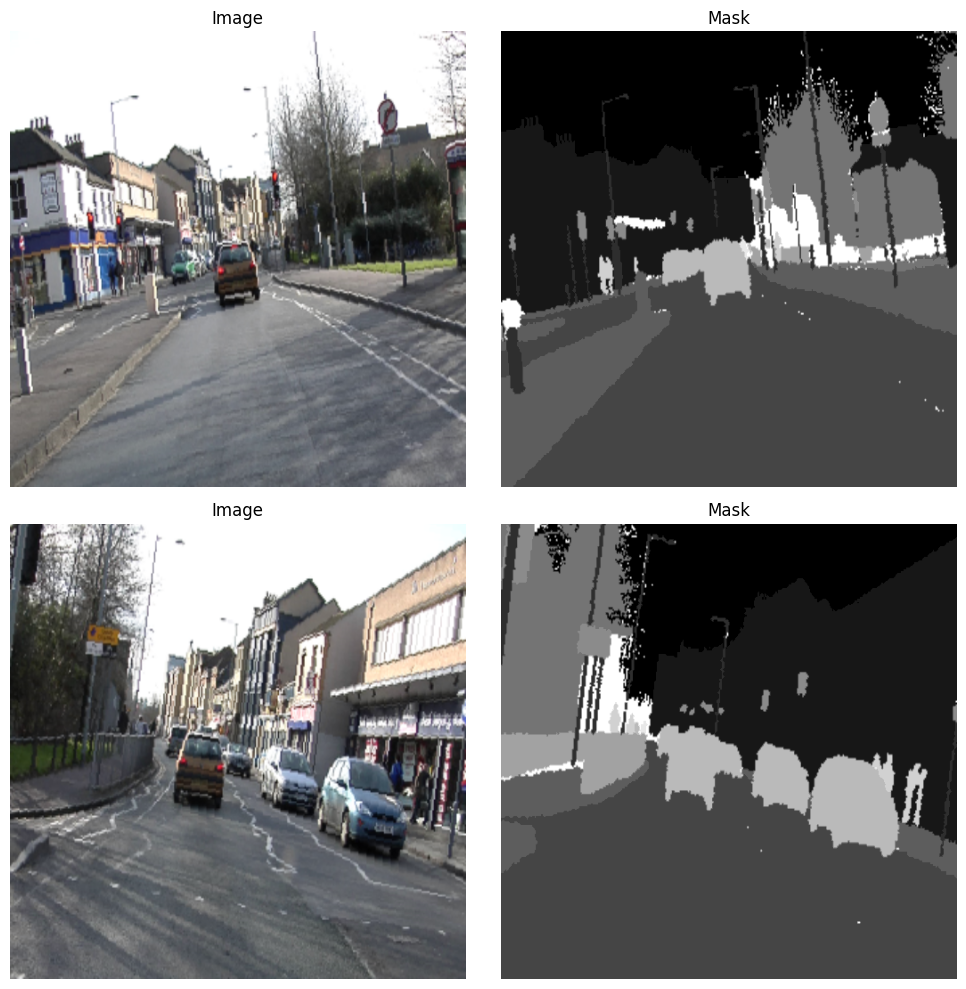

In [ ]:
plot_images_with_annotations(train_dataset, 2)


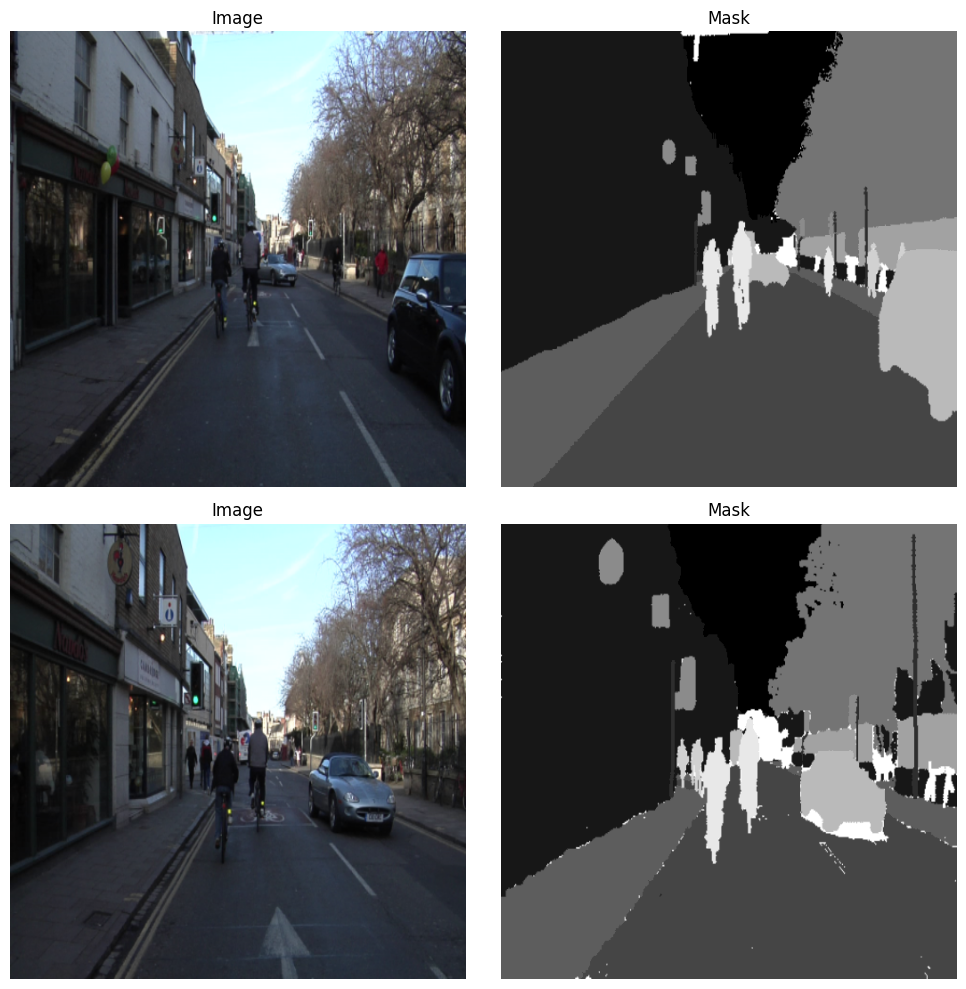

In [ ]:
plot_images_with_annotations(test_dataset, 2)


## 2. Create DataLoader

### 2.1 Create train and test dataloader

In [ ]:
import os
from torch.utils.data import DataLoader

NUM_WORKER = os.cpu_count()
# Create the DataLoader
BATCH_SIZE = 8
train_dataloader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=NUM_WORKER)
test_dataloader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=NUM_WORKER)


print(f'[INFO] Lenght of train dataloader: {len(train_dataloader)} of {BATCH_SIZE} batches')
print(f'[INFO] Lenght of test dataloader: {len(test_dataloader)} of {BATCH_SIZE} batches')


[INFO] Lenght of train dataloader: 46 of 8 batches
[INFO] Lenght of test dataloader: 13 of 8 batches


### 2.2 Visualize random image from dataloader

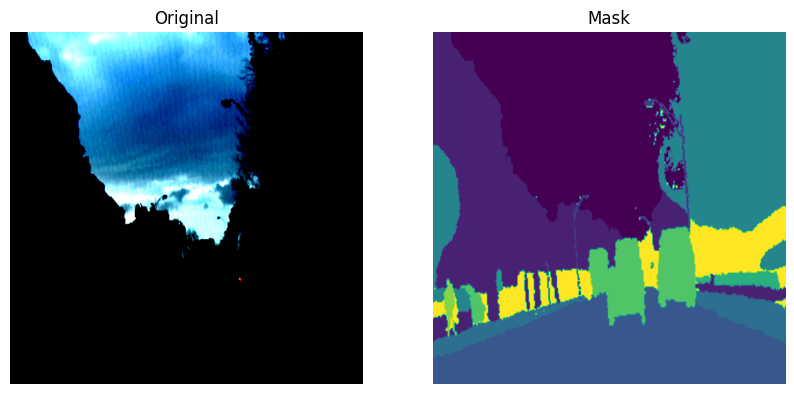

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Get a random batch
for images, masks in train_dataloader:
    break

# Select a random item from the batch
idx = np.random.randint(BATCH_SIZE)
image = images[idx]
mask = masks[idx]

# Plot the image and annotation
fig, axes = plt.subplots(1, 2, figsize=(10, 5))
axes[0].imshow(image.permute(1, 2, 0))
axes[0].set_title('Original')
axes[0].axis(False)
axes[1].imshow(mask.squeeze())
axes[1].set_title('Mask')
axes[1].axis(False)

plt.show()

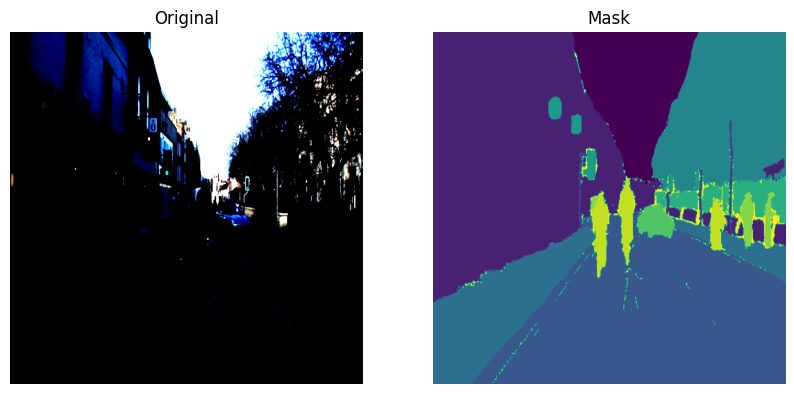

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Get a random batch
for images, masks in test_dataloader:
    break

# Select a random item from the batch
idx = np.random.randint(BATCH_SIZE)
image = images[idx]
mask = masks[idx]

# Plot the image and annotation
fig, axes = plt.subplots(1, 2, figsize=(10, 5))
axes[0].imshow(image.permute(1, 2, 0))
axes[0].set_title('Original')
axes[0].axis(False)
axes[1].imshow(mask.squeeze())
axes[1].set_title('Mask')
axes[1].axis(False)

plt.show()

## 3. Create Segmentation Models

In [ ]:
# Try to get torchinfo, install it if it doesn't work
try:
    from torchinfo import summary
except:
    print("[INFO] Couldn't find torchinfo... installing it.")
    !pip install -q torchinfo
    from torchinfo import summary

[INFO] Couldn't find torchinfo... installing it.


### 3.1 FCN VGG16

#### 3.1.1 FCN32s VGG16


In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models

class FCN32s_VGG(nn.Module):
  def __init__(self, num_classes):
    super(FCN32s_VGG, self).__init__()
    weights = models.VGG16_Weights.DEFAULT
    vgg16 = models.vgg16(weights=weights)
    vgg16_features = list(vgg16.features.children())
    self.features = nn.Sequential(*vgg16_features)

    # Freeze the features
    # for param in self.features.parameters():
    #   param.requires_grad = False

    self.classifier = nn.Sequential(
      nn.Conv2d(512, 4096, kernel_size=7, padding=3),
      nn.ReLU(inplace=True),
      nn.Dropout2d(),
      nn.Conv2d(4096, 4096, kernel_size=1),
      nn.ReLU(inplace=True),
      nn.Dropout2d(),
      nn.Conv2d(4096, num_classes, kernel_size=1)
    )

    self.upsample32x = nn.ConvTranspose2d(num_classes, num_classes, kernel_size=64, stride=32, padding=16)

  def forward(self, x):
    x = self.features(x)
    x = self.classifier(x)
    x = self.upsample32x(x)
    return x


In [ ]:
model_fcn32s = FCN32s_VGG(num_classes=NUM_CLASSES)
summary(model=model_fcn32s,
        input_size=(1, 3, 512, 512),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:02<00:00, 189MB/s]


Layer (type (var_name))                  Input Shape          Output Shape         Param #              Trainable
FCN32s_VGG (FCN32s_VGG)                  [1, 3, 512, 512]     [1, 12, 512, 512]    --                   True
├─Sequential (features)                  [1, 3, 512, 512]     [1, 512, 16, 16]     --                   True
│    └─Conv2d (0)                        [1, 3, 512, 512]     [1, 64, 512, 512]    1,792                True
│    └─ReLU (1)                          [1, 64, 512, 512]    [1, 64, 512, 512]    --                   --
│    └─Conv2d (2)                        [1, 64, 512, 512]    [1, 64, 512, 512]    36,928               True
│    └─ReLU (3)                          [1, 64, 512, 512]    [1, 64, 512, 512]    --                   --
│    └─MaxPool2d (4)                     [1, 64, 512, 512]    [1, 64, 256, 256]    --                   --
│    └─Conv2d (5)                        [1, 64, 256, 256]    [1, 128, 256, 256]   73,856               True
│    └─ReLU (6)     

#### 3.1.2 FCN16s VGG16

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models

class FCN16s_VGG(nn.Module):
  def __init__(self, num_classes):
    super(FCN16s_VGG, self).__init__()
    weights = models.VGG16_Weights.DEFAULT
    vgg16 = models.vgg16(weights=weights)
    vgg16_features = list(vgg16.features.children())
    self.features = nn.Sequential(*vgg16_features)

     # Freeze the features
    # for param in self.features.parameters():
    #   param.requires_grad = False

    self.classifier = nn.Sequential(
      nn.Conv2d(512, 4096, kernel_size=7, padding=3),
      nn.ReLU(inplace=True),
      nn.Dropout2d(),
      nn.Conv2d(4096, 4096, kernel_size=1),
      nn.ReLU(inplace=True),
      nn.Dropout2d(),
      nn.Conv2d(4096, num_classes, kernel_size=1)
    )

    self.score_pool4 = nn.Conv2d(512, num_classes, 1)
    self.upsample2x = nn.ConvTranspose2d(num_classes, num_classes, kernel_size=4, stride=2, padding=1)
    self.upsample16x = nn.ConvTranspose2d(num_classes, num_classes, kernel_size=32, stride=16, padding=8)

  def forward(self, x):
    x3 = self.features[:17](x)
    x4 = self.features[17:24](x3)
    x5 = self.features[24:](x4)

    x = self.classifier(x5)
    x = self.upsample2x(x)
    pool4 = self.score_pool4(x4)
    x = x + pool4

    x = self.upsample16x(x)
    return x


In [ ]:
model_fcn16s = FCN16s_VGG(num_classes=NUM_CLASSES)
summary(model=model_fcn16s,
        input_size=(1, 3, 512, 512),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Layer (type (var_name))                  Input Shape          Output Shape         Param #              Trainable
FCN16s_VGG (FCN16s_VGG)                  [1, 3, 512, 512]     [1, 12, 512, 512]    --                   True
├─Sequential (features)                  --                   --                   --                   True
│    └─Conv2d (0)                        [1, 3, 512, 512]     [1, 64, 512, 512]    1,792                True
│    └─ReLU (1)                          [1, 64, 512, 512]    [1, 64, 512, 512]    --                   --
│    └─Conv2d (2)                        [1, 64, 512, 512]    [1, 64, 512, 512]    36,928               True
│    └─ReLU (3)                          [1, 64, 512, 512]    [1, 64, 512, 512]    --                   --
│    └─MaxPool2d (4)                     [1, 64, 512, 512]    [1, 64, 256, 256]    --                   --
│    └─Conv2d (5)                        [1, 64, 256, 256]    [1, 128, 256, 256]   73,856               True
│    └─ReLU (6)     

#### 3.1.3 FCN8s VGG16

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models

class FCN8s_VGG(nn.Module):
  def __init__(self, num_classes):
    super(FCN8s_VGG, self).__init__()
    # Load pre-trained VGG model
    weights = models.VGG16_Weights.DEFAULT
    vgg16 = models.vgg16(weights=weights)

    # Retain the convolutional part of VGG16 and discard the fully connected layers
    vgg16_features = list(vgg16.features.children())
    self.features = nn.Sequential(*vgg16_features)

    # Freeze the features
    # for param in self.features.parameters():
    #   param.requires_grad = False

    self.classifier = nn.Sequential(
        nn.Conv2d(512, 4096, kernel_size=7, padding=3),
        nn.ReLU(inplace=True),
        nn.Dropout2d(),
        nn.Conv2d(4096, 4096, kernel_size=1),
        nn.ReLU(inplace=True),
        nn.Dropout2d(),
        nn.Conv2d(4096, num_classes, kernel_size=1)
    )

    # Convert feature maps from the VGG backbone to have `num_classes` channels
    self.score_pool4 = nn.Conv2d(512, num_classes, 1)  # layer from pool4
    self.score_pool3 = nn.Conv2d(256, num_classes, 1)  # layer from pool3

    # Upsampling layers
    self.upsample2x = nn.ConvTranspose2d(num_classes, num_classes, kernel_size=4, stride=2, padding=1)
    self.upsample8x = nn.ConvTranspose2d(num_classes, num_classes, kernel_size=16, stride=8, padding=4)

  def forward(self, x):
    # Encoder (VGG backbone)
    x3 = self.features[:17](x)  # Layer 17 output (pool3)
    x4 = self.features[17:24](x3)  # Layer 24 output (pool4)
    x5 = self.features[24:](x4)  # Final layer output

    # Fully Convolutional Classifier
    x = self.classifier(x5)

    # Upsampling and skip connections
    x = self.upsample2x(x)  # Upsample to match pool4 dimensions
    pool4 = self.score_pool4(x4)  # Reduce channel dimensions of pool4 to match x
    x = x + pool4

    x = self.upsample2x(x)  # Upsample to match pool3 dimensions
    pool3 = self.score_pool3(x3)  # Reduce channel dimensions of pool3 to match x
    x = x + pool3

    x = self.upsample8x(x)  # Final upsampling to original image size

    return x


In [ ]:
model_fcn8s_vgg = FCN8s_VGG(num_classes=NUM_CLASSES)
summary(model=model_fcn8s_vgg,
        input_size=(1, 3, 512, 512),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

NameError: name 'NUM_CLASSES' is not defined

### 3.2 FCN8s ResNet50

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models

class FCN8s_ResNet(nn.Module):
  def __init__(self, num_classes):
    super(FCN8s_ResNet, self).__init__()
    # Load pre-trained ResNet model
    weights = models.ResNet50_Weights.DEFAULT
    resnet50 = models.resnet50(weights=weights)

    self.features = nn.Sequential(*list(resnet50.children())[:-2])


    # Classifier that includes convolution layers
    self.classifier = nn.Sequential(
      nn.Conv2d(2048, 4096, kernel_size=7, padding=3),
      nn.ReLU(inplace=True),
      nn.Dropout2d(),
      nn.Conv2d(4096, 4096, kernel_size=1),
      nn.ReLU(inplace=True),
      nn.Dropout2d(),
      nn.Conv2d(4096, num_classes, kernel_size=1)
    )

    # Convert feature maps from ResNet backbone to have `num_classes` channels
    self.score_pool4 = nn.Conv2d(1024, num_classes, 1)  # layer from pool4 (res5c)
    self.score_pool3 = nn.Conv2d(512, num_classes, 1)  # layer from pool3 (res4f)

    # Upsampling layers
    self.upsample2x = nn.ConvTranspose2d(num_classes, num_classes, kernel_size=4, stride=2, padding=1)
    self.upsample8x = nn.ConvTranspose2d(num_classes, num_classes, kernel_size=16, stride=8, padding=4)

  def forward(self, x):
    # Encoder (ResNet backbone)
    x3 = self.features[:6](x)  # Output from layer 3 (res4f)
    x4 = self.features[6:7](x3)  # Output from layer 4 (res5c)
    x5 = self.features[7:](x4)  # Final layer output

    # Fully Convolutional Classifier
    x = self.classifier(x5)

    # Upsampling and skip connections
    x = self.upsample2x(x)  # Upsample to match pool4 dimensions
    pool4 = self.score_pool4(x4)  # Reduce channel dimensions of pool4 to match x
    x = x + pool4

    x = self.upsample2x(x)  # Upsample to match pool3 dimensions
    pool3 = self.score_pool3(x3)  # Reduce channel dimensions of pool3 to match x
    x = x + pool3

    x = self.upsample8x(x)  # Final upsampling to original image size

    return x


In [ ]:
model_fcn8s_restnet = FCN8s_ResNet(num_classes=NUM_CLASSES)
summary(model=model_fcn8s_restnet,
        input_size=(1, 3, 512, 512),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

### 3.3 FCN ResNet50



In [ ]:
from torchvision.models.segmentation import fcn_resnet50, FCN_ResNet50_Weights

def create_fcn_restnet50(num_classes: int):
  weights = FCN_ResNet50_Weights.DEFAULT
  model = fcn_resnet50(weights=weights)
  model.classifier[4] = torch.nn.Conv2d(512, num_classes, kernel_size=(1, 1))
  model.aux_classifier[4] = torch.nn.Conv2d(256, num_classes, kernel_size=(1, 1))
  return model


In [ ]:
NUM_CLASSES = 12
model_fcn_restnet50 = create_fcn_restnet50(num_classes=NUM_CLASSES)
summary(model=model_fcn_restnet50,
        input_size=(1, 3, 512, 512),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Downloading: "https://download.pytorch.org/models/fcn_resnet50_coco-1167a1af.pth" to /root/.cache/torch/hub/checkpoints/fcn_resnet50_coco-1167a1af.pth
100%|██████████| 135M/135M [00:03<00:00, 46.2MB/s]


Layer (type (var_name))                       Input Shape          Output Shape         Param #              Trainable
FCN (FCN)                                     [1, 3, 512, 512]     [1, 12, 512, 512]    --                   True
├─IntermediateLayerGetter (backbone)          [1, 3, 512, 512]     [1, 2048, 64, 64]    --                   True
│    └─Conv2d (conv1)                         [1, 3, 512, 512]     [1, 64, 256, 256]    9,408                True
│    └─BatchNorm2d (bn1)                      [1, 64, 256, 256]    [1, 64, 256, 256]    128                  True
│    └─ReLU (relu)                            [1, 64, 256, 256]    [1, 64, 256, 256]    --                   --
│    └─MaxPool2d (maxpool)                    [1, 64, 256, 256]    [1, 64, 128, 128]    --                   --
│    └─Sequential (layer1)                    [1, 64, 128, 128]    [1, 256, 128, 128]   --                   True
│    │    └─Bottleneck (0)                    [1, 64, 128, 128]    [1, 256, 128, 128]  

### 3.4 UNET

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class DoubleConv(nn.Module):
  """(convolution => [BN] => ReLU) * 2"""
  def __init__(self, in_channels, out_channels):
    super().__init__()
    self.double_conv = nn.Sequential(
      nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
      nn.BatchNorm2d(out_channels),
      nn.ReLU(inplace=True),
      nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
      nn.BatchNorm2d(out_channels),
      nn.ReLU(inplace=True)
    )

  def forward(self, x):
    return self.double_conv(x)

class Down(nn.Module):
  """Downscaling with maxpool then double conv"""
  def __init__(self, in_channels, out_channels):
    super().__init__()
    self.maxpool_conv = nn.Sequential(
      nn.MaxPool2d(2),
      DoubleConv(in_channels, out_channels)
    )

  def forward(self, x):
    return self.maxpool_conv(x)

class Up(nn.Module):
  """Upscaling then double conv"""
  def __init__(self, in_channels, out_channels, bilinear=True):
    super().__init__()
    if bilinear:
      self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
    else:
      self.up = nn.ConvTranspose2d(in_channels // 2, in_channels // 2, kernel_size=2, stride=2)

    self.conv = DoubleConv(in_channels, out_channels)

  def forward(self, x1, x2):
    x1 = self.up(x1)
    diffY = x2.size()[2] - x1.size()[2]
    diffX = x2.size()[3] - x1.size()[3]

    x1 = F.pad(x1, [diffX // 2, diffX - diffX // 2,
                    diffY // 2, diffY - diffY // 2])
    x = torch.cat([x2, x1], dim=1)
    return self.conv(x)

class OutConv(nn.Module):
  def __init__(self, in_channels, out_channels):
    super().__init__()
    self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=1)

  def forward(self, x):
    return self.conv(x)

class UNet(nn.Module):
  def __init__(self, n_channels, n_classes, bilinear=True):
    super(UNet, self).__init__()
    self.n_channels = n_channels
    self.n_classes = n_classes
    self.bilinear = bilinear

    self.inc = DoubleConv(n_channels, 64)
    self.down1 = Down(64, 128)
    self.down2 = Down(128, 256)
    self.down3 = Down(256, 512)
    self.down4 = Down(512, 1024 // 2)
    self.up1 = Up(1024, 512 // 2, bilinear)
    self.up2 = Up(512, 256 // 2, bilinear)
    self.up3 = Up(256, 128 // 2, bilinear)
    self.up4 = Up(128, 64, bilinear)
    self.outc = OutConv(64, n_classes)

  def forward(self, x):
    x1 = self.inc(x)
    x2 = self.down1(x1)
    x3 = self.down2(x2)
    x4 = self.down3(x3)
    x5 = self.down4(x4)
    x = self.up1(x5, x4)
    x = self.up2(x, x3)
    x = self.up3(x, x2)
    x = self.up4(x, x1)
    logits = self.outc(x)
    return logits


In [ ]:
model_unet = UNet(n_channels=3, n_classes=NUM_CLASSES)
summary(model=model_unet,
        input_size=(1, 3, 512, 512),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Layer (type (var_name))                       Input Shape          Output Shape         Param #              Trainable
UNet (UNet)                                   [1, 3, 512, 512]     [1, 12, 512, 512]    --                   True
├─DoubleConv (inc)                            [1, 3, 512, 512]     [1, 64, 512, 512]    --                   True
│    └─Sequential (double_conv)               [1, 3, 512, 512]     [1, 64, 512, 512]    --                   True
│    │    └─Conv2d (0)                        [1, 3, 512, 512]     [1, 64, 512, 512]    1,792                True
│    │    └─BatchNorm2d (1)                   [1, 64, 512, 512]    [1, 64, 512, 512]    128                  True
│    │    └─ReLU (2)                          [1, 64, 512, 512]    [1, 64, 512, 512]    --                   --
│    │    └─Conv2d (3)                        [1, 64, 512, 512]    [1, 64, 512, 512]    36,928               True
│    │    └─BatchNorm2d (4)                   [1, 64, 512, 512]    [1, 64, 512, 512] 

### 3.5 UNET ResNet50

In [ ]:
import torch
import torch.nn as nn
import torchvision
import torchvision.models as models


class ConvBlock(nn.Module):
    """
    Helper module that consists of a Conv -> BN -> ReLU
    """

    def __init__(self, in_channels, out_channels, padding=1, kernel_size=3, stride=1, with_nonlinearity=True):
        super().__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, padding=padding, kernel_size=kernel_size, stride=stride)
        self.bn = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU()
        self.with_nonlinearity = with_nonlinearity

    def forward(self, x):
        x = self.conv(x)
        x = self.bn(x)
        if self.with_nonlinearity:
            x = self.relu(x)
        return x


class Bridge(nn.Module):
    """
    This is the middle layer of the UNet which just consists of some
    """

    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.bridge = nn.Sequential(
            ConvBlock(in_channels, out_channels),
            ConvBlock(out_channels, out_channels)
        )

    def forward(self, x):
        return self.bridge(x)


class UpBlockForUNetWithResNet50(nn.Module):
    """
    Up block that encapsulates one up-sampling step which consists of Upsample -> ConvBlock -> ConvBlock
    """

    def __init__(self, in_channels, out_channels, up_conv_in_channels=None, up_conv_out_channels=None,
                 upsampling_method="conv_transpose"):
        super().__init__()

        if up_conv_in_channels == None:
            up_conv_in_channels = in_channels
        if up_conv_out_channels == None:
            up_conv_out_channels = out_channels

        if upsampling_method == "conv_transpose":
            self.upsample = nn.ConvTranspose2d(up_conv_in_channels, up_conv_out_channels, kernel_size=2, stride=2)
        elif upsampling_method == "bilinear":
            self.upsample = nn.Sequential(
                nn.Upsample(mode='bilinear', scale_factor=2),
                nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=1)
            )
        self.conv_block_1 = ConvBlock(in_channels, out_channels)
        self.conv_block_2 = ConvBlock(out_channels, out_channels)

    def forward(self, up_x, down_x):
        """

        :param up_x: this is the output from the previous up block
        :param down_x: this is the output from the down block
        :return: upsampled feature map
        """
        x = self.upsample(up_x)
        x = torch.cat([x, down_x], 1)
        x = self.conv_block_1(x)
        x = self.conv_block_2(x)
        return x


class Unet_Resnet50(nn.Module):
    DEPTH = 6

    def __init__(self, num_classes=2):
        super().__init__()
        weights = models.ResNet50_Weights.DEFAULT
        resnet = models.resnet50(weights=weights)
        down_blocks = []
        up_blocks = []
        self.input_block = nn.Sequential(*list(resnet.children()))[:3]
        self.input_pool = list(resnet.children())[3]
        for bottleneck in list(resnet.children()):
            if isinstance(bottleneck, nn.Sequential):
                down_blocks.append(bottleneck)
        self.down_blocks = nn.ModuleList(down_blocks)
        self.bridge = Bridge(2048, 2048)
        up_blocks.append(UpBlockForUNetWithResNet50(2048, 1024))
        up_blocks.append(UpBlockForUNetWithResNet50(1024, 512))
        up_blocks.append(UpBlockForUNetWithResNet50(512, 256))
        up_blocks.append(UpBlockForUNetWithResNet50(in_channels=128 + 64, out_channels=128,
                                                    up_conv_in_channels=256, up_conv_out_channels=128))
        up_blocks.append(UpBlockForUNetWithResNet50(in_channels=64 + 3, out_channels=64,
                                                    up_conv_in_channels=128, up_conv_out_channels=64))

        self.up_blocks = nn.ModuleList(up_blocks)

        self.out = nn.Conv2d(64, num_classes, kernel_size=1, stride=1)

    def forward(self, x, with_output_feature_map=False):
        pre_pools = dict()
        pre_pools[f"layer_0"] = x
        x = self.input_block(x)
        pre_pools[f"layer_1"] = x
        x = self.input_pool(x)

        for i, block in enumerate(self.down_blocks, 2):
            x = block(x)
            if i == (Unet_Resnet50.DEPTH - 1):
                continue
            pre_pools[f"layer_{i}"] = x

        x = self.bridge(x)

        for i, block in enumerate(self.up_blocks, 1):
            key = f"layer_{Unet_Resnet50.DEPTH - 1 - i}"
            x = block(x, pre_pools[key])
        output_feature_map = x
        x = self.out(x)
        del pre_pools
        if with_output_feature_map:
            return x, output_feature_map
        else:
            return x

In [ ]:
model_unet_resnet = Unet_Resnet50(num_classes=12)
summary(model=model_unet_resnet,
        input_size=(1, 3, 512, 512),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:01<00:00, 61.5MB/s]


Layer (type (var_name))                       Input Shape          Output Shape         Param #              Trainable
Unet_Resnet50 (Unet_Resnet50)                 [1, 3, 512, 512]     [1, 12, 512, 512]    --                   True
├─Sequential (input_block)                    [1, 3, 512, 512]     [1, 64, 256, 256]    --                   True
│    └─Conv2d (0)                             [1, 3, 512, 512]     [1, 64, 256, 256]    9,408                True
│    └─BatchNorm2d (1)                        [1, 64, 256, 256]    [1, 64, 256, 256]    128                  True
│    └─ReLU (2)                               [1, 64, 256, 256]    [1, 64, 256, 256]    --                   --
├─MaxPool2d (input_pool)                      [1, 64, 256, 256]    [1, 64, 128, 128]    --                   --
├─ModuleList (down_blocks)                    --                   --                   --                   True
│    └─Sequential (0)                         [1, 64, 128, 128]    [1, 256, 128, 128]  

### 3.6 LR-ASPP

Lite Reduced Atrous Spatial Pyramid Pooling

In [ ]:
from torchvision.models.segmentation import lraspp_mobilenet_v3_large, LRASPP_MobileNet_V3_Large_Weights

def create_lraspp_mobilenet(num_classes: int):
  weights = LRASPP_MobileNet_V3_Large_Weights.DEFAULT
  model = lraspp_mobilenet_v3_large(weights=weights)
  model.classifier.low_classifier = torch.nn.Conv2d(40, num_classes, kernel_size=(1, 1), stride=(1, 1))
  model.classifier.high_classifier = torch.nn.Conv2d(128, num_classes, kernel_size=(1, 1), stride=(1, 1))
  return model

In [ ]:
model_lraspp = create_lraspp_mobilenet(num_classes=NUM_CLASSES)
summary(model=model_lraspp,
        input_size=(1, 3, 512, 512),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Downloading: "https://download.pytorch.org/models/lraspp_mobilenet_v3_large-d234d4ea.pth" to /root/.cache/torch/hub/checkpoints/lraspp_mobilenet_v3_large-d234d4ea.pth
100%|██████████| 12.5M/12.5M [00:00<00:00, 66.9MB/s]


Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
LRASPP (LRASPP)                                              [1, 3, 512, 512]     [1, 12, 512, 512]    --                   True
├─IntermediateLayerGetter (backbone)                         [1, 3, 512, 512]     [1, 960, 32, 32]     --                   True
│    └─Conv2dNormActivation (0)                              [1, 3, 512, 512]     [1, 16, 256, 256]    --                   True
│    │    └─Conv2d (0)                                       [1, 3, 512, 512]     [1, 16, 256, 256]    432                  True
│    │    └─BatchNorm2d (1)                                  [1, 16, 256, 256]    [1, 16, 256, 256]    32                   True
│    │    └─Hardswish (2)                                    [1, 16, 256, 256]    [1, 16, 256, 256]    --                   --
│    └─InvertedResidual (1)                                  [1, 16, 256, 256]    [1, 16, 256,

### 3.7 DeeplabV3

In [ ]:
from torchvision.models.segmentation import deeplabv3_mobilenet_v3_large, DeepLabV3_MobileNet_V3_Large_Weights

def create_deeplabv3_mobilenet(num_classes: int):
  weights = DeepLabV3_MobileNet_V3_Large_Weights.DEFAULT
  model = deeplabv3_mobilenet_v3_large(weights=weights)
  model.classifier[4] = torch.nn.Conv2d(256, num_classes, kernel_size=(1, 1))
  model.aux_classifier[4] = torch.nn.Conv2d(10, num_classes, kernel_size=(1, 1))
  return model

In [ ]:
model_deeplabv3 = create_deeplabv3_mobilenet(num_classes=12)
summary(model=model_deeplabv3,
        input_size=(1, 3, 512, 512),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Downloading: "https://download.pytorch.org/models/deeplabv3_mobilenet_v3_large-fc3c493d.pth" to /root/.cache/torch/hub/checkpoints/deeplabv3_mobilenet_v3_large-fc3c493d.pth
100%|██████████| 42.3M/42.3M [00:01<00:00, 32.8MB/s]


Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
DeepLabV3 (DeepLabV3)                                        [1, 3, 512, 512]     [1, 12, 512, 512]    --                   True
├─IntermediateLayerGetter (backbone)                         [1, 3, 512, 512]     [1, 960, 32, 32]     --                   True
│    └─Conv2dNormActivation (0)                              [1, 3, 512, 512]     [1, 16, 256, 256]    --                   True
│    │    └─Conv2d (0)                                       [1, 3, 512, 512]     [1, 16, 256, 256]    432                  True
│    │    └─BatchNorm2d (1)                                  [1, 16, 256, 256]    [1, 16, 256, 256]    32                   True
│    │    └─Hardswish (2)                                    [1, 16, 256, 256]    [1, 16, 256, 256]    --                   --
│    └─InvertedResidual (1)                                  [1, 16, 256, 256]    [1, 16, 256,

## 4. Create Engine

### 4.1 Create `DiceLoss` and `EarlyStopping`

In [ ]:
import torch
import torch.nn as nn

class DiceLoss(nn.Module):
  def __init__(self, smooth=1e-6):
    super(DiceLoss, self).__init__()
    self.smooth = smooth

  def forward(self, outputs, targets):
    # Apply softmax to the outputs to get class probabilities
    outputs = torch.softmax(outputs, dim=1)
    # One-hot encode targets
    targets = torch.nn.functional.one_hot(targets, num_classes=outputs.shape[1]).permute(0, 3, 1, 2).float()

    intersection = torch.sum(outputs * targets, dim=(0, 2, 3))
    cardinality = torch.sum(outputs + targets, dim=(0, 2, 3))

    dice_score = (2. * intersection + self.smooth) / (cardinality + self.smooth)
    # We use '1 - dice_score' because we want to minimize the loss
    return 1 - dice_score.mean()  # Average across all classes



In [ ]:
class EarlyStopping:
  """
  Early stopping to stop the training when the loss does not improve after

  Args:
  -----
      patience (int): Number of epochs to wait before stopping the training.
      verbose (bool): If True, prints a message for each epoch where the loss
                      does not improve.
      delta (float): Minimum change in the monitored quantity to qualify as an improvement.
  """
  def __init__(self, patience=7, verbose=False, delta=0):
    self.patience = patience
    self.verbose = verbose
    self.counter = 0
    self.best_score = None
    self.early_stop = False
    self.delta = delta

  def __call__(self, val_loss):
    """
    Args:
    -----
        val_loss (float): The validation loss to check if the model performance improved.

    Returns:
    --------
        bool: True if the loss did not improve, False if it improved.
    """
    score = -val_loss

    if self.best_score is None:
        self.best_score = score
    elif score < self.best_score + self.delta:
        self.counter += 1
        if self.counter >= self.patience:
            self.early_stop = True
    else:
        self.best_score = score
        self.counter = 0

### 4.2 Create `Engine`

In [ ]:
import torch
from torch import nn
from torch.utils.data import DataLoader
from torch.utils.tensorboard import SummaryWriter
from torch.cuda.amp import autocast
from tqdm import tqdm
import time
from datetime import datetime
from typing import Dict
import os
import gc


class Engine:
  """
    Training class
  """
  def __init__(self,
              model: nn.Module,
              train_loader: DataLoader,
              test_loader: DataLoader,
              loss_fn: nn.Module,
              optimizer: torch.optim.Optimizer,
              scaler: torch.cuda.amp.GradScaler,
              scheduler: torch.optim.lr_scheduler.ReduceLROnPlateau,
              experiment: Dict,
              writer: SummaryWriter,
              device: torch.device):

    self.experiment = experiment
    self.patience = experiment["early_stopping"]
    self.early_stopping = EarlyStopping(patience=self.patience)
    self.model = model
    self.train_loader = train_loader
    self.test_loader = test_loader
    self.optimizer = optimizer
    self.loss_fn = loss_fn
    self.scheduler = scheduler
    self.scaler = scaler
    self.writer = writer
    self.device = device


  def run(self):
    epochs, checkpoint_dir  = self.experiment["num_epochs"], self.experiment["checkpoint_dir"]
    best_epoch = 0
    dice_loss = 0.5
    start_time = time.time()
    for epoch in range(epochs):
        current_epoch = epoch+1
        print(f"Epoch {current_epoch}/{epochs}")

        # Train phase
        average_train_loss = self.train_epoch(self.model, self.train_loader, self.loss_fn, self.optimizer, self.scaler, self.device)
        print(f'Training Loss: {average_train_loss:.4f}')

        # Evaluate phase
        average_test_loss = self.evaluate(self.model, self.test_loader, self.loss_fn, self.device)
        print(f'Testing Loss: {average_test_loss:.4f}\n')


        self.scheduler.step(average_test_loss)
        self.early_stopping(average_test_loss)

        # Checkpoint and log if this epoch improves the best Dice Coefficient
        if average_test_loss < dice_loss:
          dice_loss = average_test_loss
          best_epoch = current_epoch
          epoch_end_time = time.time()
          epoch_training_time = (epoch_end_time - start_time) / 60
          print(f"[INFO] Creating best model checkpoint...")
          torch.save(self.model.state_dict(), f"{checkpoint_dir}/best_model.pth")
          torch.save(
              {
              'epoch': best_epoch,
              'dice_loss': dice_loss,
              'training_time': epoch_training_time,
              'experiment_setup': self.experiment,
              },
              f"{checkpoint_dir}/checkpoint.pth")
          print(f"[INFO] Checkpoint saved at {checkpoint_dir}\n")

        self.writer.add_scalars("Loss", {"train_loss": average_train_loss, "test_loss": average_test_loss}, current_epoch)

        del average_train_loss, average_test_loss


        if self.early_stopping.early_stop:
          print(f"[INFO]Early Stopping at epoch {current_epoch} after waiting {self.patience} epochs")
          print(f"[INFO]Total training time {epoch_training_time:.2f} minutes")
          break


    if not self.early_stopping.early_stop:
      end_time = time.time()
      training_time = (end_time - start_time) / 60
      print(f"[INFO] Finishing training  {epochs} epochs for {training_time:.2f} minutes")

    self.writer.close()
    print(f"[INFO] Training completed with best Dice Loss of {dice_loss:.4f} at epoch {best_epoch}\n")

    del dice_loss
    torch.cuda.empty_cache()
    gc.collect()


    return self.early_stopping.early_stop


  def train_epoch(self,
                model: nn.Module,
                dataloader: DataLoader,
                loss_fn: DiceLoss,
                optimizer: torch.optim.Optimizer,
                scaler: torch.cuda.amp.GradScaler,
                device: torch.device) -> float:
    model.train()

    total_loss = 0.0
    valid_batches = 0

    for data, targets in tqdm(dataloader, desc="Train", leave=False):
      data_device, targets_device = data.to(device), targets.to(device).squeeze(1).long()
      optimizer.zero_grad()
      with autocast():
        outputs = model(data_device)
        if isinstance(outputs, dict) and 'out' in outputs:
          outputs = outputs['out']
        loss = loss_fn(outputs, targets_device)
        if torch.isnan(loss):
          print("\n[INFO] NaN detected in loss, skipping update.")
          continue  # Skip this batch

      scaler.scale(loss).backward()
      scaler.step(optimizer)
      scaler.update()

      total_loss += loss.item() * data.size(0)
      valid_batches += 1

      # Delete locals
      del data_device, targets_device

    average_loss = total_loss / sum(d.size(0) for d, _ in dataloader if d.size(0)) if valid_batches > 0 else float('nan')

    del total_loss

    return average_loss

  def evaluate(self,
               model: nn.Module,
               dataloader: DataLoader,
               loss_fn: DiceLoss,  # Specify that loss_fn is expected to be DiceLoss
               device: torch.device) -> float:
    model.eval()
    total_loss = 0.0
    with torch.inference_mode():
      for data, targets in tqdm(dataloader, desc="Evaluate", leave=False):
        data_device, targets_device = data.to(device), targets.to(device).squeeze(1).long()
        outputs = model(data_device)
        if isinstance(outputs, dict) and 'out' in outputs:
          outputs = outputs['out']
        loss = loss_fn(outputs, targets_device)
        total_loss += loss.item() * data.size(0)

      # Delete locals
      del data_device, targets_device

    avg_loss = total_loss / len(dataloader.dataset)

    del total_loss

    return avg_loss




## 5. Create Utils

### 5.1 Create `infer_and_plot()`

In [ ]:
import torch
import matplotlib.pyplot as plt
import time

def infer_and_plot_dataset(title: str, model: torch.nn.Module, dataset: torch.utils.data.Dataset, device: torch.device, num_images: int = 1):
    # Set the model to evaluation mode
    model.eval()
    image_count = 0


    for idx in range(len(dataset)):
        if image_count >= num_images:
            break  # Stop processing once the specified number of images has been reached

        # Retrieve the image and mask from the dataset
        input_image, mask = dataset[idx]

        # Move image to the appropriate device
        input_image = input_image.unsqueeze(0).to(device)

        # Perform inference
        with torch.inference_mode():
            start_time = time.time()
            output = model(input_image)
            end_time = time.time()
            if isinstance(output, dict) and 'out' in output:
                output = output['out']

        # Process output to produce a segmentation map
        output_prediction = output.argmax(1).cpu().detach().squeeze()

        # Plotting the image, original mask, and predicted segmentation
        fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(15, 5))
        input_image = unnormalize(input_image.cpu().detach().squeeze())
        axs[0].imshow(input_image.permute(1, 2, 0))
        axs[0].axis('off')
        axs[0].set_title('Input Image')

        axs[1].imshow(mask.squeeze(), cmap='gray')
        axs[1].axis('off')
        axs[1].set_title('Original Mask')

        latency = end_time - start_time

        axs[2].imshow(output_prediction, cmap='viridis')
        axs[2].axis('off')
        axs[2].set_title(f'{title} | latency: {latency:.4f}s')

        plt.tight_layout()
        plt.show()

        image_count += 1  # Increment the image count

    return latency


## 6. EXPERIMENTS START HERE

We will use hyperparameters:

* Input Shape:
 * `512x512`
* Batch Sizes:
 * `8`
* Learning Rates:
 * `1e-3`
 * `5e-4`
* Epochs:
 * 1000 with **Early Stopping**
* Early Stoppings:
 * patience: `10`
* Models:
 * `fcn8s_vgg16`
 * `fcn8s_resnet50`
 * `fcn_resnet50`
 * `unet`
 *  `unet_resnet5`
 *  `lr_aspp`
 * `deeplab_v3`
* Optimizer:
 * Adam
* Scheduler
 * ReduceLROnPlateau:
    * patience: `3`
    * factor: `0.5`
    * min_lr: `1e-6`



### 6.1 Setup experiments

In [ ]:
RUNS_DIR = '/content/drive/MyDrive/Experiment/runs/'
CHECKPOINTS_DIR = '/content/drive/MyDrive/Experiment/checkpoints/'


model_names = ["fcn8s_vgg16", "fcn8s_resnet50", "fcn_resnet50", "unet", "unet_resnet50", "lr_aspp", "deeplab_v3"]
learning_rates = [1e-3, 5e-4]
batch_sizes = [8]


In [ ]:
def create_model(model_name: str, num_classes:int=12):
  if model_name == "fcn8s_vgg16":
    return FCN8s_VGG(num_classes=num_classes)

  elif model_name == "fcn8s_resnet50":
    return FCN8s_ResNet(num_classes=num_classes)

  elif model_name == "fcn_resnet50":
    return create_fcn_restnet50(num_classes=num_classes)

  elif model_name == "unet":
    return UNet(n_channels=3, n_classes=num_classes)

  elif model_name == "unet_resnet50":
    return  Unet_Resnet50(num_classes=num_classes)

  elif model_name == "lr_aspp":
    return create_lraspp_mobilenet(num_classes=num_classes)

  else:
    return create_deeplabv3_mobilenet(num_classes=num_classes)

In [ ]:
from datetime import datetime
import os

def create_summary_writer(experiment_name: str,
                          model_name: str,
                          extra: str):

  timestamp = datetime.now().strftime("%Y-%m-%d")


  logs_dir = os.path.join(RUNS_DIR, timestamp, experiment_name, model_name)
  checkpoint_dir = os.path.join(CHECKPOINTS_DIR, timestamp, experiment_name, model_name, extra)

  if not os.path.exists(checkpoint_dir):
      os.makedirs(checkpoint_dir)

  writer = SummaryWriter(log_dir=logs_dir)
  return writer, checkpoint_dir



### 6.2 Run Multiple Experiments

In [ ]:
from torch.utils.tensorboard import SummaryWriter
import os
import gc

experiment = 0
for batch_size in batch_sizes:
   # Create dataloader
  NUM_WORKER = os.cpu_count()
  train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=NUM_WORKER)
  test_dataloader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=NUM_WORKER)

  for learning_rate in learning_rates:
    for model_name in model_names:
      experiment += 1
      print(f"\n\n[INFO] Number Experiment: {experiment}")
      print(f"[INFO] Training with {model_name}, learning rate {learning_rate}, and batch size {batch_size}")

      # Create model and send to device
      model = create_model(model_name=model_name, num_classes=NUM_CLASSES)
      model.to(device)

      # Define loss function, optimizer, scheduler, and scaler
      loss_fn = DiceLoss()
      optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
      scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=3, verbose=True, factor=0.5, min_lr=1e-6)
      scaler = torch.cuda.amp.GradScaler()

      # Create writer
      experiment_name = f"{experiment}_base_train"
      extra = f"10_early_stopping_{learning_rate}_learning_rate_{batch_size}_batch_size"
      writer, checkpoint_dir = create_summary_writer(experiment_name, model_name, extra)
      print(f"[INFO] Checkpoint dir: {checkpoint_dir}\n")
      print("*****"*20+"\n")

      experiment_setup = {
          'num_epochs': 1000,
          'early_stopping': 10,
          'checkpoint_dir': checkpoint_dir,
          'model_name': model_name,
          'learning_rate': learning_rate,
          'batch_size': batch_size
      }

      # Create engine
      engine = Engine(model=model,
                train_loader=train_dataloader,
                test_loader=test_dataloader,
                loss_fn=loss_fn,
                optimizer=optimizer,
                scheduler=scheduler,
                scaler=scaler,
                experiment=experiment_setup,
                writer=writer,
                device=device)

      # Run engine
      early_stop = engine.run()

      del model, optimizer, scheduler, scaler, writer, engine
      torch.cuda.empty_cache()
      gc.collect()

      if early_stop:
        continue

  # del train_dataloader, test_dataloader
  # torch.cuda.empty_cache()
  # gc.collect()






[INFO] Number Experiment: 1
[INFO] Training with fcn8s_vgg16, learning rate 0.001, and batch size 8


Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:02<00:00, 185MB/s]
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


[INFO] Checkpoint dir: /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/1_base_train/fcn8s_vgg16/10_early_stopping_0.001_learning_rate_8_batch_size

****************************************************************************************************

Epoch 1/1000


Train:   0%|          | 0/46 [00:00<?, ?it/s]/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Training Loss: 0.7655


Testing Loss: 0.6886

Epoch 2/1000


Training Loss: 0.6577


Testing Loss: 0.6048

Epoch 3/1000


Training Loss: 0.6030


Testing Loss: 0.5760

Epoch 4/1000


Training Loss: 0.5821


Testing Loss: 0.5642

Epoch 5/1000


Training Loss: 0.5552


Testing Loss: 0.5181

Epoch 6/1000


Training Loss: 0.5455


Testing Loss: 0.5361

Epoch 7/1000


Training Loss: 0.5341


Testing Loss: 0.4974

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/1_base_train/fcn8s_vgg16/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 8/1000


Training Loss: 0.5173


Testing Loss: 0.4989

Epoch 9/1000


Training Loss: 0.4976


Testing Loss: 0.4981

Epoch 10/1000


Training Loss: 0.4876


Testing Loss: 0.4388

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/1_base_train/fcn8s_vgg16/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 11/1000


Training Loss: 0.4728


Testing Loss: 0.4600

Epoch 12/1000


Training Loss: 0.4714


Testing Loss: 0.4460

Epoch 13/1000


Training Loss: 0.4543


Testing Loss: 0.4629

Epoch 14/1000


Training Loss: 0.4412


Testing Loss: 0.4516

Epoch 15/1000


Training Loss: 0.4190


Testing Loss: 0.4048

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/1_base_train/fcn8s_vgg16/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 16/1000


Training Loss: 0.4029


Testing Loss: 0.4183

Epoch 17/1000


Training Loss: 0.3941


Testing Loss: 0.3999

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/1_base_train/fcn8s_vgg16/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 18/1000


Training Loss: 0.3875


Testing Loss: 0.4064

Epoch 19/1000


Training Loss: 0.3813


Testing Loss: 0.3855

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/1_base_train/fcn8s_vgg16/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 20/1000


Training Loss: 0.3730


Testing Loss: 0.3634

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/1_base_train/fcn8s_vgg16/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 21/1000


Training Loss: 0.3707


Testing Loss: 0.3737

Epoch 22/1000


Training Loss: 0.3622


Testing Loss: 0.3948

Epoch 23/1000


Training Loss: 0.3582


Testing Loss: 0.3691

Epoch 24/1000


Training Loss: 0.3494


Testing Loss: 0.3428

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/1_base_train/fcn8s_vgg16/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 25/1000


Training Loss: 0.3465


Testing Loss: 0.3747

Epoch 26/1000


Training Loss: 0.3407


Testing Loss: 0.3875

Epoch 27/1000


Training Loss: 0.3407


Testing Loss: 0.3549

Epoch 28/1000


Training Loss: 0.3339


Testing Loss: 0.3499

Epoch 29/1000


Training Loss: 0.3213


Testing Loss: 0.3427

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/1_base_train/fcn8s_vgg16/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 30/1000


Training Loss: 0.3187


Testing Loss: 0.3456

Epoch 31/1000


Training Loss: 0.3148


Testing Loss: 0.3364

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/1_base_train/fcn8s_vgg16/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 32/1000


Training Loss: 0.3123


Testing Loss: 0.3466

Epoch 33/1000


Training Loss: 0.3074


Testing Loss: 0.3357

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/1_base_train/fcn8s_vgg16/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 34/1000


Training Loss: 0.3036


Testing Loss: 0.3554

Epoch 35/1000


Training Loss: 0.3041


Testing Loss: 0.3359

Epoch 36/1000


Training Loss: 0.3017


Testing Loss: 0.3478

Epoch 37/1000


Training Loss: 0.2975


Testing Loss: 0.3573

Epoch 38/1000


Training Loss: 0.2936


Testing Loss: 0.3269

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/1_base_train/fcn8s_vgg16/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 39/1000


Training Loss: 0.2940


Testing Loss: 0.3120

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/1_base_train/fcn8s_vgg16/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 40/1000


Training Loss: 0.2915


Testing Loss: 0.3295

Epoch 41/1000


Training Loss: 0.2898


Testing Loss: 0.3102

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/1_base_train/fcn8s_vgg16/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 42/1000


Training Loss: 0.2872


Testing Loss: 0.3198

Epoch 43/1000


Training Loss: 0.2869


Testing Loss: 0.3408

Epoch 44/1000


Training Loss: 0.2892


Testing Loss: 0.3242

Epoch 45/1000


Training Loss: 0.2847


Testing Loss: 0.3433

Epoch 46/1000


Training Loss: 0.2876


Testing Loss: 0.3429

Epoch 47/1000


Training Loss: 0.2844


Testing Loss: 0.3383

Epoch 48/1000


Training Loss: 0.2889


Testing Loss: 0.3341

Epoch 49/1000


Training Loss: 0.2822


Testing Loss: 0.3393

Epoch 50/1000


Training Loss: 0.2818


Testing Loss: 0.3400

Epoch 51/1000


Training Loss: 0.2839


Testing Loss: 0.3423

[INFO]Early Stopping at epoch 51 after waiting 10 epochs
[INFO]Total training time 6.05 minutes
[INFO] Training completed with best Dice Loss of 0.3102 at epoch 41



[INFO] Number Experiment: 2
[INFO] Training with fcn8s_resnet50, learning rate 0.001, and batch size 8


Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 171MB/s]


[INFO] Checkpoint dir: /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/2_base_train/fcn8s_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

****************************************************************************************************

Epoch 1/1000


Training Loss: 0.7372


Testing Loss: 0.6192

Epoch 2/1000


Training Loss: 0.5824


Testing Loss: 0.5408

Epoch 3/1000


Training Loss: 0.5381


Testing Loss: 0.5140

Epoch 4/1000


Training Loss: 0.5071


Testing Loss: 0.4837

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/2_base_train/fcn8s_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 5/1000


Training Loss: 0.4769


Testing Loss: 0.4764

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/2_base_train/fcn8s_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 6/1000


Training Loss: 0.4484


Testing Loss: 0.4295

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/2_base_train/fcn8s_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 7/1000


Training Loss: 0.4296


Testing Loss: 0.4385

Epoch 8/1000


Training Loss: 0.4230


Testing Loss: 0.4417

Epoch 9/1000


Training Loss: 0.3996


Testing Loss: 0.3993

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/2_base_train/fcn8s_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 10/1000


Training Loss: 0.3815


Testing Loss: 0.3585

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/2_base_train/fcn8s_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 11/1000


Training Loss: 0.3710


Testing Loss: 0.5796

Epoch 12/1000


Training Loss: 0.3594


Testing Loss: 0.3113

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/2_base_train/fcn8s_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 13/1000


Training Loss: 0.3497


Testing Loss: 0.3516

Epoch 14/1000


Training Loss: 0.3377


Testing Loss: 0.3578

Epoch 15/1000


Training Loss: 0.3297


Testing Loss: 0.3701

Epoch 16/1000


Training Loss: 0.3293


Testing Loss: 0.3326

Epoch 17/1000


Training Loss: 0.3097


Testing Loss: 0.3123

Epoch 18/1000


Training Loss: 0.3015


Testing Loss: 0.3335

Epoch 19/1000


Training Loss: 0.2945


Testing Loss: 0.2919

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/2_base_train/fcn8s_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 20/1000


Training Loss: 0.2873


Testing Loss: 0.2955

Epoch 21/1000


Training Loss: 0.2842


Testing Loss: 0.2693

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/2_base_train/fcn8s_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 22/1000


Training Loss: 0.2848


Testing Loss: 0.3050

Epoch 23/1000


Training Loss: 0.2815


Testing Loss: 0.3022

Epoch 24/1000


Training Loss: 0.2735


Testing Loss: 0.2850

Epoch 25/1000


Training Loss: 0.2759


Testing Loss: 0.2694

Epoch 26/1000


Training Loss: 0.2666


Testing Loss: 0.2752

Epoch 27/1000


Training Loss: 0.2669


Testing Loss: 0.2648

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/2_base_train/fcn8s_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 28/1000


Training Loss: 0.2629


Testing Loss: 0.2736

Epoch 29/1000


Training Loss: 0.2621


Testing Loss: 0.2763

Epoch 30/1000


Training Loss: 0.2635


Testing Loss: 0.2817

Epoch 31/1000


Training Loss: 0.2589


Testing Loss: 0.2685

Epoch 32/1000


Training Loss: 0.2572


Testing Loss: 0.2637

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/2_base_train/fcn8s_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 33/1000


Training Loss: 0.2552


Testing Loss: 0.2700

Epoch 34/1000


Training Loss: 0.2536


Testing Loss: 0.2705

Epoch 35/1000


Training Loss: 0.2556


Testing Loss: 0.2694

Epoch 36/1000


Training Loss: 0.2504


Testing Loss: 0.2699

Epoch 37/1000


Training Loss: 0.2493


Testing Loss: 0.2677

Epoch 38/1000


Training Loss: 0.2505


Testing Loss: 0.2682

Epoch 39/1000


Training Loss: 0.2471


Testing Loss: 0.2659

Epoch 40/1000


Training Loss: 0.2476


Testing Loss: 0.2660

Epoch 41/1000


Training Loss: 0.2425


Testing Loss: 0.2640

Epoch 42/1000


Training Loss: 0.2463


Testing Loss: 0.2651

[INFO]Early Stopping at epoch 42 after waiting 10 epochs
[INFO]Total training time 6.46 minutes
[INFO] Training completed with best Dice Loss of 0.2637 at epoch 32



[INFO] Number Experiment: 3
[INFO] Training with fcn_resnet50, learning rate 0.001, and batch size 8


Downloading: "https://download.pytorch.org/models/fcn_resnet50_coco-1167a1af.pth" to /root/.cache/torch/hub/checkpoints/fcn_resnet50_coco-1167a1af.pth
100%|██████████| 135M/135M [00:00<00:00, 163MB/s]


[INFO] Checkpoint dir: /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/3_base_train/fcn_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

****************************************************************************************************

Epoch 1/1000


Training Loss: 0.6186


Testing Loss: 0.5907

Epoch 2/1000


Training Loss: 0.5252


Testing Loss: 0.5033

Epoch 3/1000


Training Loss: 0.4922


Testing Loss: 0.4659

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/3_base_train/fcn_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 4/1000


Training Loss: 0.4555


Testing Loss: 0.4856

Epoch 5/1000


Training Loss: 0.4509


Testing Loss: 0.3988

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/3_base_train/fcn_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 6/1000


Training Loss: 0.4146


Testing Loss: 0.4702

Epoch 7/1000


Training Loss: 0.3987


Testing Loss: 0.3542

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/3_base_train/fcn_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 8/1000


Training Loss: 0.3825


Testing Loss: 0.3540

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/3_base_train/fcn_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 9/1000


Training Loss: 0.3784


Testing Loss: 0.4067

Epoch 10/1000


Training Loss: 0.3581


Testing Loss: 0.3199

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/3_base_train/fcn_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 11/1000


Training Loss: 0.3482


Testing Loss: 0.3112

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/3_base_train/fcn_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 12/1000


Training Loss: 0.3322


Testing Loss: 0.3510

Epoch 13/1000


Training Loss: 0.3273


Testing Loss: 0.3710

Epoch 14/1000


Training Loss: 0.3232


Testing Loss: 0.3306

Epoch 15/1000


Training Loss: 0.3175


Testing Loss: 0.3312

Epoch 16/1000


Training Loss: 0.3011


Testing Loss: 0.3022

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/3_base_train/fcn_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 17/1000


Training Loss: 0.2867


Testing Loss: 0.2961

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/3_base_train/fcn_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 18/1000


Training Loss: 0.2828


Testing Loss: 0.2719

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/3_base_train/fcn_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 19/1000


Training Loss: 0.2728


Testing Loss: 0.2828

Epoch 20/1000


Training Loss: 0.2779


Testing Loss: 0.2729

Epoch 21/1000


Training Loss: 0.2697


Testing Loss: 0.2688

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/3_base_train/fcn_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 22/1000


Training Loss: 0.2683


Testing Loss: 0.2865

Epoch 23/1000


Training Loss: 0.2636


Testing Loss: 0.2984

Epoch 24/1000


Training Loss: 0.2663


Testing Loss: 0.2767

Epoch 25/1000


Training Loss: 0.2642


Testing Loss: 0.2920

Epoch 26/1000


Training Loss: 0.2588


Testing Loss: 0.2550

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/3_base_train/fcn_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 27/1000


Training Loss: 0.2488


Testing Loss: 0.2535

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/3_base_train/fcn_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 28/1000


Training Loss: 0.2468


Testing Loss: 0.2639

Epoch 29/1000


Training Loss: 0.2449


Testing Loss: 0.2651

Epoch 30/1000


Training Loss: 0.2437


Testing Loss: 0.2511

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/3_base_train/fcn_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 31/1000


Training Loss: 0.2408


Testing Loss: 0.2520

Epoch 32/1000


Training Loss: 0.2429


Testing Loss: 0.2565

Epoch 33/1000


Training Loss: 0.2408


Testing Loss: 0.2567

Epoch 34/1000


Training Loss: 0.2395


Testing Loss: 0.2592

Epoch 35/1000


Training Loss: 0.2310


Testing Loss: 0.2579

Epoch 36/1000


Training Loss: 0.2346


Testing Loss: 0.2512

Epoch 37/1000


Training Loss: 0.2304


Testing Loss: 0.2553

Epoch 38/1000


Training Loss: 0.2298


Testing Loss: 0.2490

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/3_base_train/fcn_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 39/1000


Training Loss: 0.2285


Testing Loss: 0.2530

Epoch 40/1000


Training Loss: 0.2279


Testing Loss: 0.2535

Epoch 41/1000


Training Loss: 0.2255


Testing Loss: 0.2563

Epoch 42/1000


Training Loss: 0.2278


Testing Loss: 0.2496

Epoch 43/1000


Training Loss: 0.2241


Testing Loss: 0.2474

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/3_base_train/fcn_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 44/1000


Training Loss: 0.2220


Testing Loss: 0.2459

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/3_base_train/fcn_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 45/1000


Training Loss: 0.2225


Testing Loss: 0.2483

Epoch 46/1000


Training Loss: 0.2215


Testing Loss: 0.2451

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/3_base_train/fcn_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 47/1000


Training Loss: 0.2239


Testing Loss: 0.2485

Epoch 48/1000


Training Loss: 0.2212


Testing Loss: 0.2461

Epoch 49/1000


Training Loss: 0.2206


Testing Loss: 0.2476

Epoch 50/1000


Training Loss: 0.2218


Testing Loss: 0.2470

Epoch 51/1000


Training Loss: 0.2180


Testing Loss: 0.2454

Epoch 52/1000


Training Loss: 0.2184


Testing Loss: 0.2451

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/3_base_train/fcn_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 53/1000


Training Loss: 0.2148


Testing Loss: 0.2463

Epoch 54/1000


Training Loss: 0.2222


Testing Loss: 0.2463

Epoch 55/1000


Training Loss: 0.2176


Testing Loss: 0.2448

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/3_base_train/fcn_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 56/1000


Training Loss: 0.2153


Testing Loss: 0.2459

Epoch 57/1000


Training Loss: 0.2201


Testing Loss: 0.2491

Epoch 58/1000


Training Loss: 0.2173


Testing Loss: 0.2461

Epoch 59/1000


Training Loss: 0.2161


Testing Loss: 0.2475

Epoch 60/1000


Training Loss: 0.2155


Testing Loss: 0.2481

Epoch 61/1000


Training Loss: 0.2133


Testing Loss: 0.2461

Epoch 62/1000


Training Loss: 0.2149


Testing Loss: 0.2478

Epoch 63/1000


Training Loss: 0.2203


Testing Loss: 0.2482

Epoch 64/1000


Training Loss: 0.2159


Testing Loss: 0.2464

Epoch 65/1000


Training Loss: 0.2157


Testing Loss: 0.2448

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/3_base_train/fcn_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 66/1000


Training Loss: 0.2166


Testing Loss: 0.2465

Epoch 67/1000


Training Loss: 0.2146


Testing Loss: 0.2464

Epoch 68/1000


Training Loss: 0.2205


Testing Loss: 0.2478

Epoch 69/1000


Training Loss: 0.2157


Testing Loss: 0.2468

Epoch 70/1000


Training Loss: 0.2125


Testing Loss: 0.2460

Epoch 71/1000


Training Loss: 0.2156


Testing Loss: 0.2461

Epoch 72/1000


Training Loss: 0.2142


Testing Loss: 0.2470

Epoch 73/1000


Training Loss: 0.2129


Testing Loss: 0.2481

Epoch 74/1000


Training Loss: 0.2166


Testing Loss: 0.2464

Epoch 75/1000


Training Loss: 0.2149


Testing Loss: 0.2459

[INFO]Early Stopping at epoch 75 after waiting 10 epochs
[INFO]Total training time 9.88 minutes
[INFO] Training completed with best Dice Loss of 0.2448 at epoch 65



[INFO] Number Experiment: 4
[INFO] Training with unet, learning rate 0.001, and batch size 8
[INFO] Checkpoint dir: /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/4_base_train/unet/10_early_stopping_0.001_learning_rate_8_batch_size

****************************************************************************************************

Epoch 1/1000


Training Loss: 0.7967


Testing Loss: 0.7975

Epoch 2/1000


Training Loss: 0.7037


Testing Loss: 0.7447

Epoch 3/1000


Training Loss: 0.6503


Testing Loss: 0.6184

Epoch 4/1000


Training Loss: 0.6140


Testing Loss: 0.6354

Epoch 5/1000


Training Loss: 0.5828


Testing Loss: 0.5948

Epoch 6/1000


Training Loss: 0.5582


Testing Loss: 0.5549

Epoch 7/1000


Training Loss: 0.5450


Testing Loss: 0.6272

Epoch 8/1000


Training Loss: 0.5301


Testing Loss: 0.5251

Epoch 9/1000


Training Loss: 0.5204


Testing Loss: 0.5700

Epoch 10/1000


Training Loss: 0.5094


Testing Loss: 0.4513

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/4_base_train/unet/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 11/1000


Training Loss: 0.5018


Testing Loss: 0.4763

Epoch 12/1000


Training Loss: 0.4970


Testing Loss: 0.5032

Epoch 13/1000


Training Loss: 0.4869


Testing Loss: 0.4409

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/4_base_train/unet/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 14/1000


Training Loss: 0.4912


Testing Loss: 0.4994

Epoch 15/1000


Training Loss: 0.4916


Testing Loss: 0.4890

Epoch 16/1000


Training Loss: 0.4790


Testing Loss: 0.5217

Epoch 17/1000


Training Loss: 0.4653


Testing Loss: 0.4669

Epoch 18/1000


Training Loss: 0.4462


Testing Loss: 0.4298

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/4_base_train/unet/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 19/1000


Training Loss: 0.4334


Testing Loss: 0.3712

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/4_base_train/unet/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 20/1000


Training Loss: 0.4235


Testing Loss: 0.3733

Epoch 21/1000


Training Loss: 0.4293


Testing Loss: 0.4257

Epoch 22/1000


Training Loss: 0.4197


Testing Loss: 0.4205

Epoch 23/1000


Training Loss: 0.4172


Testing Loss: 0.4290

Epoch 24/1000


Training Loss: 0.4062


Testing Loss: 0.3723

Epoch 25/1000


Training Loss: 0.3994


Testing Loss: 0.3834

Epoch 26/1000


Training Loss: 0.3956


Testing Loss: 0.3727

Epoch 27/1000


Training Loss: 0.3899


Testing Loss: 0.3799

Epoch 28/1000


Training Loss: 0.3838


Testing Loss: 0.3492

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/4_base_train/unet/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 29/1000


Training Loss: 0.3780


Testing Loss: 0.3636

Epoch 30/1000


Training Loss: 0.3787


Testing Loss: 0.3516

Epoch 31/1000


Training Loss: 0.3768


Testing Loss: 0.3680

Epoch 32/1000


Training Loss: 0.3766


Testing Loss: 0.3595

Epoch 33/1000


Training Loss: 0.3719


Testing Loss: 0.3629

Epoch 34/1000


Training Loss: 0.3671


Testing Loss: 0.3561

Epoch 35/1000


Training Loss: 0.3649


Testing Loss: 0.3549

Epoch 36/1000


Training Loss: 0.3643


Testing Loss: 0.3611

Epoch 37/1000


Training Loss: 0.3615


Testing Loss: 0.3565

Epoch 38/1000


Training Loss: 0.3601


Testing Loss: 0.3492

[INFO]Early Stopping at epoch 38 after waiting 10 epochs
[INFO]Total training time 5.13 minutes
[INFO] Training completed with best Dice Loss of 0.3492 at epoch 28



[INFO] Number Experiment: 5
[INFO] Training with unet_resnet50, learning rate 0.001, and batch size 8
[INFO] Checkpoint dir: /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/5_base_train/unet_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

****************************************************************************************************

Epoch 1/1000


Training Loss: 0.7544


Testing Loss: 0.7061

Epoch 2/1000


Training Loss: 0.6182


Testing Loss: 0.6125

Epoch 3/1000


Training Loss: 0.5566


Testing Loss: 0.5672

Epoch 4/1000


Training Loss: 0.5245


Testing Loss: 0.5409

Epoch 5/1000


Training Loss: 0.4945


Testing Loss: 0.5146

Epoch 6/1000


Training Loss: 0.4775


Testing Loss: 0.4837

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/5_base_train/unet_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 7/1000


Training Loss: 0.4538


Testing Loss: 0.4828

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/5_base_train/unet_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 8/1000


Training Loss: 0.4345


Testing Loss: 0.4737

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/5_base_train/unet_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 9/1000


Training Loss: 0.4186


Testing Loss: 0.3937

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/5_base_train/unet_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 10/1000


Training Loss: 0.4098


Testing Loss: 0.4111

Epoch 11/1000


Training Loss: 0.3988


Testing Loss: 0.4760

Epoch 12/1000


Training Loss: 0.3860


Testing Loss: 0.4154

Epoch 13/1000


Training Loss: 0.3652


Testing Loss: 0.3851

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/5_base_train/unet_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 14/1000


Training Loss: 0.3573


Testing Loss: 0.3714

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/5_base_train/unet_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 15/1000


Training Loss: 0.3459


Testing Loss: 0.4123

Epoch 16/1000


Training Loss: 0.3517


Testing Loss: 0.3175

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/5_base_train/unet_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 17/1000


Training Loss: 0.3333


Testing Loss: 0.3407

Epoch 18/1000


Training Loss: 0.3233


Testing Loss: 0.3035

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/5_base_train/unet_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 19/1000


Training Loss: 0.3289


Testing Loss: 0.3312

Epoch 20/1000


Training Loss: 0.3106


Testing Loss: 0.2963

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/5_base_train/unet_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 21/1000


Training Loss: 0.2975


Testing Loss: 0.3452

Epoch 22/1000


Training Loss: 0.3165


Testing Loss: 0.3435

Epoch 23/1000


Training Loss: 0.2999


Testing Loss: 0.3017

Epoch 24/1000


Training Loss: 0.3005


Testing Loss: 0.3598

Epoch 25/1000


Training Loss: 0.2875


Testing Loss: 0.2946

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/5_base_train/unet_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 26/1000


Training Loss: 0.2743


Testing Loss: 0.2623

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/5_base_train/unet_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 27/1000


Training Loss: 0.2701


Testing Loss: 0.2885

Epoch 28/1000


Training Loss: 0.2623


Testing Loss: 0.2932

Epoch 29/1000


Training Loss: 0.2588


Testing Loss: 0.2729

Epoch 30/1000


Training Loss: 0.2566


Testing Loss: 0.2765

Epoch 31/1000


Training Loss: 0.2565


Testing Loss: 0.2727

Epoch 32/1000


Training Loss: 0.2514


Testing Loss: 0.2668

Epoch 33/1000


Training Loss: 0.2479


Testing Loss: 0.2421

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/5_base_train/unet_resnet50/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 34/1000


Training Loss: 0.2455


Testing Loss: 0.2559

Epoch 35/1000


Training Loss: 0.2459


Testing Loss: 0.2458

Epoch 36/1000


Training Loss: 0.2445


Testing Loss: 0.2676

Epoch 37/1000


Training Loss: 0.2391


Testing Loss: 0.2639

Epoch 38/1000


Training Loss: 0.2409


Testing Loss: 0.2704

Epoch 39/1000


Training Loss: 0.2391


Testing Loss: 0.2494

Epoch 40/1000


Training Loss: 0.2376


Testing Loss: 0.2551

Epoch 41/1000


Training Loss: 0.2402


Testing Loss: 0.2457

Epoch 42/1000


Training Loss: 0.2353


Testing Loss: 0.2466

Epoch 43/1000


Training Loss: 0.2374


Testing Loss: 0.2464

[INFO]Early Stopping at epoch 43 after waiting 10 epochs
[INFO]Total training time 6.95 minutes
[INFO] Training completed with best Dice Loss of 0.2421 at epoch 33



Downloading: "https://download.pytorch.org/models/lraspp_mobilenet_v3_large-d234d4ea.pth" to /root/.cache/torch/hub/checkpoints/lraspp_mobilenet_v3_large-d234d4ea.pth




[INFO] Number Experiment: 6
[INFO] Training with lr_aspp, learning rate 0.001, and batch size 8


100%|██████████| 12.5M/12.5M [00:00<00:00, 93.5MB/s]


[INFO] Checkpoint dir: /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/6_base_train/lr_aspp/10_early_stopping_0.001_learning_rate_8_batch_size

****************************************************************************************************

Epoch 1/1000


Training Loss: 0.6067


Testing Loss: 0.5727

Epoch 2/1000


Training Loss: 0.4364


Testing Loss: 0.4189

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/6_base_train/lr_aspp/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 3/1000


Training Loss: 0.3885


Testing Loss: 0.3700

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/6_base_train/lr_aspp/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 4/1000


Training Loss: 0.3580


Testing Loss: 0.3535

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/6_base_train/lr_aspp/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 5/1000


Training Loss: 0.3398


Testing Loss: 0.3151

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/6_base_train/lr_aspp/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 6/1000


Training Loss: 0.3255


Testing Loss: 0.3132

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/6_base_train/lr_aspp/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 7/1000


Training Loss: 0.3198


Testing Loss: 0.3045

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/6_base_train/lr_aspp/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 8/1000


Training Loss: 0.3070


Testing Loss: 0.3100

Epoch 9/1000


Training Loss: 0.3006


Testing Loss: 0.3108

Epoch 10/1000


Training Loss: 0.2998


Testing Loss: 0.3293

Epoch 11/1000


Training Loss: 0.2903


Testing Loss: 0.2874

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/6_base_train/lr_aspp/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 12/1000


Training Loss: 0.2911


Testing Loss: 0.2949

Epoch 13/1000


Training Loss: 0.2869


Testing Loss: 0.2877

Epoch 14/1000


Training Loss: 0.2843


Testing Loss: 0.2909

Epoch 15/1000


Training Loss: 0.2774


Testing Loss: 0.3203

Epoch 16/1000


Training Loss: 0.2724


Testing Loss: 0.2855

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/6_base_train/lr_aspp/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 17/1000


Training Loss: 0.2658


Testing Loss: 0.2796

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/6_base_train/lr_aspp/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 18/1000


Training Loss: 0.2663


Testing Loss: 0.2700

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/6_base_train/lr_aspp/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 19/1000


Training Loss: 0.2622


Testing Loss: 0.2716

Epoch 20/1000


Training Loss: 0.2628


Testing Loss: 0.2731

Epoch 21/1000


Training Loss: 0.2606


Testing Loss: 0.2773

Epoch 22/1000


Training Loss: 0.2574


Testing Loss: 0.2702

Epoch 23/1000


Training Loss: 0.2559


Testing Loss: 0.2700

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/6_base_train/lr_aspp/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 24/1000


Training Loss: 0.2511


Testing Loss: 0.2710

Epoch 25/1000


Training Loss: 0.2588


Testing Loss: 0.2711

Epoch 26/1000


Training Loss: 0.2506


Testing Loss: 0.2775

Epoch 27/1000


Training Loss: 0.2534


Testing Loss: 0.2814

Epoch 28/1000


Training Loss: 0.2515


Testing Loss: 0.2766

Epoch 29/1000


Training Loss: 0.2485


Testing Loss: 0.2748

Epoch 30/1000


Training Loss: 0.2496


Testing Loss: 0.2695

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/6_base_train/lr_aspp/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 31/1000


Training Loss: 0.2500


Testing Loss: 0.2722

Epoch 32/1000


Training Loss: 0.2515


Testing Loss: 0.2724

Epoch 33/1000


Training Loss: 0.2488


Testing Loss: 0.2683

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/6_base_train/lr_aspp/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 34/1000


Training Loss: 0.2522


Testing Loss: 0.2689

Epoch 35/1000


Training Loss: 0.2462


Testing Loss: 0.2702

Epoch 36/1000


Training Loss: 0.2429


Testing Loss: 0.2661

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/6_base_train/lr_aspp/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 37/1000


Training Loss: 0.2501


Testing Loss: 0.2722

Epoch 38/1000


Training Loss: 0.2424


Testing Loss: 0.2703

Epoch 39/1000


Training Loss: 0.2449


Testing Loss: 0.2734

Epoch 40/1000


Training Loss: 0.2482


Testing Loss: 0.2719

Epoch 41/1000


Training Loss: 0.2426


Testing Loss: 0.2667

Epoch 42/1000


Training Loss: 0.2401


Testing Loss: 0.2665

Epoch 43/1000


Training Loss: 0.2380


Testing Loss: 0.2666

Epoch 44/1000


Training Loss: 0.2451


Testing Loss: 0.2686

Epoch 45/1000


Training Loss: 0.2407


Testing Loss: 0.2691

Epoch 46/1000


Training Loss: 0.2414


Testing Loss: 0.2672

[INFO]Early Stopping at epoch 46 after waiting 10 epochs
[INFO]Total training time 4.26 minutes
[INFO] Training completed with best Dice Loss of 0.2661 at epoch 36



[INFO] Number Experiment: 7
[INFO] Training with deeplab_v3, learning rate 0.001, and batch size 8


Downloading: "https://download.pytorch.org/models/deeplabv3_mobilenet_v3_large-fc3c493d.pth" to /root/.cache/torch/hub/checkpoints/deeplabv3_mobilenet_v3_large-fc3c493d.pth
100%|██████████| 42.3M/42.3M [00:00<00:00, 153MB/s]


[INFO] Checkpoint dir: /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/7_base_train/deeplab_v3/10_early_stopping_0.001_learning_rate_8_batch_size

****************************************************************************************************

Epoch 1/1000


Training Loss: 0.5992


Testing Loss: 0.5433

Epoch 2/1000


Training Loss: 0.4695


Testing Loss: 0.4806

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/7_base_train/deeplab_v3/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 3/1000


Training Loss: 0.4207


Testing Loss: 0.4401

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/7_base_train/deeplab_v3/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 4/1000


Training Loss: 0.3867


Testing Loss: 0.3567

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/7_base_train/deeplab_v3/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 5/1000


Training Loss: 0.3716


Testing Loss: 0.3464

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/7_base_train/deeplab_v3/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 6/1000


Training Loss: 0.3508


Testing Loss: 0.3257

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/7_base_train/deeplab_v3/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 7/1000


Training Loss: 0.3389


Testing Loss: 0.3580

Epoch 8/1000


Training Loss: 0.3315


Testing Loss: 0.3213

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/7_base_train/deeplab_v3/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 9/1000


Training Loss: 0.3185


Testing Loss: 0.3253

Epoch 10/1000


Training Loss: 0.3147


Testing Loss: 0.3130

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/7_base_train/deeplab_v3/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 11/1000


Training Loss: 0.3092


Testing Loss: 0.3112

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/7_base_train/deeplab_v3/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 12/1000


Training Loss: 0.3128


Testing Loss: 0.3059

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/7_base_train/deeplab_v3/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 13/1000


Training Loss: 0.3050


Testing Loss: 0.3035

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/7_base_train/deeplab_v3/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 14/1000


Training Loss: 0.2992


Testing Loss: 0.3220

Epoch 15/1000


Training Loss: 0.2949


Testing Loss: 0.3018

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/7_base_train/deeplab_v3/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 16/1000


Training Loss: 0.2869


Testing Loss: 0.2897

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/7_base_train/deeplab_v3/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 17/1000


Training Loss: 0.2857


Testing Loss: 0.2819

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/7_base_train/deeplab_v3/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 18/1000


Training Loss: 0.2834


Testing Loss: 0.3098

Epoch 19/1000


Training Loss: 0.2811


Testing Loss: 0.3138

Epoch 20/1000


Training Loss: 0.2784


Testing Loss: 0.3014

Epoch 21/1000


Training Loss: 0.2819


Testing Loss: 0.2956

Epoch 22/1000


Training Loss: 0.2749


Testing Loss: 0.2778

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/7_base_train/deeplab_v3/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 23/1000


Training Loss: 0.2656


Testing Loss: 0.2805

Epoch 24/1000


Training Loss: 0.2668


Testing Loss: 0.2768

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/7_base_train/deeplab_v3/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 25/1000


Training Loss: 0.2662


Testing Loss: 0.2773

Epoch 26/1000


Training Loss: 0.2674


Testing Loss: 0.2802

Epoch 27/1000


Training Loss: 0.2652


Testing Loss: 0.2799

Epoch 28/1000


Training Loss: 0.2593


Testing Loss: 0.2849

Epoch 29/1000


Training Loss: 0.2582


Testing Loss: 0.2771

Epoch 30/1000


Training Loss: 0.2584


Testing Loss: 0.2712

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/7_base_train/deeplab_v3/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 31/1000


Training Loss: 0.2570


Testing Loss: 0.2715

Epoch 32/1000


Training Loss: 0.2579


Testing Loss: 0.2712

Epoch 33/1000


Training Loss: 0.2558


Testing Loss: 0.2706

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/7_base_train/deeplab_v3/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 34/1000


Training Loss: 0.2535


Testing Loss: 0.2692

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/7_base_train/deeplab_v3/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 35/1000


Training Loss: 0.2532


Testing Loss: 0.2704

Epoch 36/1000


Training Loss: 0.2526


Testing Loss: 0.2694

Epoch 37/1000


Training Loss: 0.2542


Testing Loss: 0.2713

Epoch 38/1000


Training Loss: 0.2560


Testing Loss: 0.2676

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/7_base_train/deeplab_v3/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 39/1000


Training Loss: 0.2498


Testing Loss: 0.2704

Epoch 40/1000


Training Loss: 0.2540


Testing Loss: 0.2711

Epoch 41/1000


Training Loss: 0.2544


Testing Loss: 0.2729

Epoch 42/1000


Training Loss: 0.2537


Testing Loss: 0.2654

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/7_base_train/deeplab_v3/10_early_stopping_0.001_learning_rate_8_batch_size

Epoch 43/1000


Training Loss: 0.2498


Testing Loss: 0.2681

Epoch 44/1000


Training Loss: 0.2492


Testing Loss: 0.2703

Epoch 45/1000


Training Loss: 0.2462


Testing Loss: 0.2664

Epoch 46/1000


Training Loss: 0.2520


Testing Loss: 0.2703

Epoch 47/1000


Training Loss: 0.2473


Testing Loss: 0.2713

Epoch 48/1000


Training Loss: 0.2473


Testing Loss: 0.2719

Epoch 49/1000


Training Loss: 0.2467


Testing Loss: 0.2685

Epoch 50/1000


Training Loss: 0.2429


Testing Loss: 0.2678

Epoch 51/1000


Training Loss: 0.2483


Testing Loss: 0.2701

Epoch 52/1000


Training Loss: 0.2463


Testing Loss: 0.2708

[INFO]Early Stopping at epoch 52 after waiting 10 epochs
[INFO]Total training time 5.75 minutes
[INFO] Training completed with best Dice Loss of 0.2654 at epoch 42



[INFO] Number Experiment: 8
[INFO] Training with fcn8s_vgg16, learning rate 0.0005, and batch size 8
[INFO] Checkpoint dir: /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/8_base_train/fcn8s_vgg16/10_early_stopping_0.0005_learning_rate_8_batch_size

****************************************************************************************************

Epoch 1/1000


Training Loss: 0.7448


Testing Loss: 0.6161

Epoch 2/1000


Training Loss: 0.6023


Testing Loss: 0.5777

Epoch 3/1000


Training Loss: 0.5573


Testing Loss: 0.5100

Epoch 4/1000


Training Loss: 0.5316


Testing Loss: 0.4572

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/8_base_train/fcn8s_vgg16/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 5/1000


Training Loss: 0.5111


Testing Loss: 0.4604

Epoch 6/1000


Training Loss: 0.4873


Testing Loss: 0.4276

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/8_base_train/fcn8s_vgg16/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 7/1000


Training Loss: 0.4691


Testing Loss: 0.4362

Epoch 8/1000


Training Loss: 0.4748


Testing Loss: 0.4224

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/8_base_train/fcn8s_vgg16/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 9/1000


Training Loss: 0.4511


Testing Loss: 0.4288

Epoch 10/1000


Training Loss: 0.4320


Testing Loss: 0.4189

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/8_base_train/fcn8s_vgg16/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 11/1000


Training Loss: 0.4163


Testing Loss: 0.3919

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/8_base_train/fcn8s_vgg16/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 12/1000


Training Loss: 0.4068


Testing Loss: 0.3534

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/8_base_train/fcn8s_vgg16/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 13/1000


Training Loss: 0.3998


Testing Loss: 0.3807

Epoch 14/1000


Training Loss: 0.3904


Testing Loss: 0.3564

Epoch 15/1000


Training Loss: 0.3726


Testing Loss: 0.3424

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/8_base_train/fcn8s_vgg16/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 16/1000


Training Loss: 0.3677


Testing Loss: 0.3475

Epoch 17/1000


Training Loss: 0.3579


Testing Loss: 0.3652

Epoch 18/1000


Training Loss: 0.3661


Testing Loss: 0.3555

Epoch 19/1000


Training Loss: 0.3532


Testing Loss: 0.3491

Epoch 20/1000


Training Loss: 0.3334


Testing Loss: 0.3149

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/8_base_train/fcn8s_vgg16/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 21/1000


Training Loss: 0.3222


Testing Loss: 0.3174

Epoch 22/1000


Training Loss: 0.3201


Testing Loss: 0.3060

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/8_base_train/fcn8s_vgg16/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 23/1000


Training Loss: 0.3156


Testing Loss: 0.2964

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/8_base_train/fcn8s_vgg16/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 24/1000


Training Loss: 0.3123


Testing Loss: 0.2967

Epoch 25/1000


Training Loss: 0.3059


Testing Loss: 0.3045

Epoch 26/1000


Training Loss: 0.3089


Testing Loss: 0.3034

Epoch 27/1000


Training Loss: 0.2966


Testing Loss: 0.2972

Epoch 28/1000


Training Loss: 0.2916


Testing Loss: 0.2941

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/8_base_train/fcn8s_vgg16/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 29/1000


Training Loss: 0.2907


Testing Loss: 0.2925

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/8_base_train/fcn8s_vgg16/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 30/1000


Training Loss: 0.2894


Testing Loss: 0.2899

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/8_base_train/fcn8s_vgg16/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 31/1000


Training Loss: 0.2823


Testing Loss: 0.2957

Epoch 32/1000


Training Loss: 0.2859


Testing Loss: 0.2966

Epoch 33/1000


Training Loss: 0.2793


Testing Loss: 0.3027

Epoch 34/1000


Training Loss: 0.2813


Testing Loss: 0.2997

Epoch 35/1000


Training Loss: 0.2785


Testing Loss: 0.2899

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/8_base_train/fcn8s_vgg16/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 36/1000


Training Loss: 0.2763


Testing Loss: 0.2904

Epoch 37/1000


Training Loss: 0.2780


Testing Loss: 0.2952

Epoch 38/1000


Training Loss: 0.2754


Testing Loss: 0.2905

Epoch 39/1000


Training Loss: 0.2698


Testing Loss: 0.2962

Epoch 40/1000


Training Loss: 0.2769


Testing Loss: 0.2964

Epoch 41/1000


Training Loss: 0.2671


Testing Loss: 0.2990

Epoch 42/1000


Training Loss: 0.2696


Testing Loss: 0.2962

Epoch 43/1000


Training Loss: 0.2664


Testing Loss: 0.2930

Epoch 44/1000


Training Loss: 0.2701


Testing Loss: 0.2949

Epoch 45/1000


Training Loss: 0.2688


Testing Loss: 0.2936

[INFO]Early Stopping at epoch 45 after waiting 10 epochs
[INFO]Total training time 5.36 minutes
[INFO] Training completed with best Dice Loss of 0.2899 at epoch 35



[INFO] Number Experiment: 9
[INFO] Training with fcn8s_resnet50, learning rate 0.0005, and batch size 8
[INFO] Checkpoint dir: /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

****************************************************************************************************

Epoch 1/1000


Training Loss: 0.7910


Testing Loss: 0.6255

Epoch 2/1000


Training Loss: 0.5775


Testing Loss: 0.5351

Epoch 3/1000


Training Loss: 0.5321


Testing Loss: 0.5323

Epoch 4/1000


Training Loss: 0.4992


Testing Loss: 0.4929

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 5/1000


Training Loss: 0.4802


Testing Loss: 0.5213

Epoch 6/1000


Training Loss: 0.4647


Testing Loss: 0.5005

Epoch 7/1000


Training Loss: 0.4506


Testing Loss: 0.4443

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 8/1000


Training Loss: 0.4339


Testing Loss: 0.4202

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 9/1000


Training Loss: 0.4245


Testing Loss: 0.4161

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 10/1000


Training Loss: 0.4031


Testing Loss: 0.4135

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 11/1000


Training Loss: 0.3809


Testing Loss: 0.3782

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 12/1000


Training Loss: 0.3706


Testing Loss: 0.3648

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 13/1000


Training Loss: 0.3681


Testing Loss: 0.3788

Epoch 14/1000


Training Loss: 0.3551


Testing Loss: 0.3547

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 15/1000


Training Loss: 0.3455


Testing Loss: 0.3673

Epoch 16/1000


Training Loss: 0.3332


Testing Loss: 0.3710

Epoch 17/1000


Training Loss: 0.3276


Testing Loss: 0.3379

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 18/1000


Training Loss: 0.3181


Testing Loss: 0.3342

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 19/1000


Training Loss: 0.3165


Testing Loss: 0.3245

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 20/1000


Training Loss: 0.3104


Testing Loss: 0.3304

Epoch 21/1000


Training Loss: 0.3039


Testing Loss: 0.3324

Epoch 22/1000


Training Loss: 0.3023


Testing Loss: 0.3357

Epoch 23/1000


Training Loss: 0.3022


Testing Loss: 0.3225

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 24/1000


Training Loss: 0.2955


Testing Loss: 0.3177

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 25/1000


Training Loss: 0.2913


Testing Loss: 0.3216

Epoch 26/1000


Training Loss: 0.2888


Testing Loss: 0.3245

Epoch 27/1000


Training Loss: 0.2844


Testing Loss: 0.3098

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 28/1000


Training Loss: 0.2846


Testing Loss: 0.3120

Epoch 29/1000


Training Loss: 0.2798


Testing Loss: 0.3105

Epoch 30/1000


Training Loss: 0.2854


Testing Loss: 0.3452

Epoch 31/1000


Training Loss: 0.2787


Testing Loss: 0.3068

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 32/1000


Training Loss: 0.2777


Testing Loss: 0.3092

Epoch 33/1000


Training Loss: 0.2728


Testing Loss: 0.3067

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 34/1000


Training Loss: 0.2727


Testing Loss: 0.3155

Epoch 35/1000


Training Loss: 0.2670


Testing Loss: 0.3090

Epoch 36/1000


Training Loss: 0.2690


Testing Loss: 0.3207

Epoch 37/1000


Training Loss: 0.2709


Testing Loss: 0.3064

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 38/1000


Training Loss: 0.2657


Testing Loss: 0.3017

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 39/1000


Training Loss: 0.2654


Testing Loss: 0.3031

Epoch 40/1000


Training Loss: 0.2608


Testing Loss: 0.2986

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 41/1000


Training Loss: 0.2613


Testing Loss: 0.3072

Epoch 42/1000


Training Loss: 0.2613


Testing Loss: 0.3036

Epoch 43/1000


Training Loss: 0.2616


Testing Loss: 0.2999

Epoch 44/1000


Training Loss: 0.2569


Testing Loss: 0.2956

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 45/1000


Training Loss: 0.2540


Testing Loss: 0.3005

Epoch 46/1000


Training Loss: 0.2553


Testing Loss: 0.2895

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 47/1000


Training Loss: 0.2537


Testing Loss: 0.3037

Epoch 48/1000


Training Loss: 0.2518


Testing Loss: 0.2931

Epoch 49/1000


Training Loss: 0.2547


Testing Loss: 0.2926

Epoch 50/1000


Training Loss: 0.2515


Testing Loss: 0.2958

Epoch 51/1000


Training Loss: 0.2443


Testing Loss: 0.2918

Epoch 52/1000


Training Loss: 0.2453


Testing Loss: 0.2931

Epoch 53/1000


Training Loss: 0.2453


Testing Loss: 0.2873

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 54/1000


Training Loss: 0.2446


Testing Loss: 0.2883

Epoch 55/1000


Training Loss: 0.2404


Testing Loss: 0.2893

Epoch 56/1000


Training Loss: 0.2401


Testing Loss: 0.2917

Epoch 57/1000


Training Loss: 0.2411


Testing Loss: 0.2854

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 58/1000


Training Loss: 0.2394


Testing Loss: 0.2829

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 59/1000


Training Loss: 0.2408


Testing Loss: 0.2831

Epoch 60/1000


Training Loss: 0.2377


Testing Loss: 0.2857

Epoch 61/1000


Training Loss: 0.2386


Testing Loss: 0.2804

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 62/1000


Training Loss: 0.2354


Testing Loss: 0.2813

Epoch 63/1000


Training Loss: 0.2330


Testing Loss: 0.2808

Epoch 64/1000


Training Loss: 0.2344


Testing Loss: 0.2797

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 65/1000


Training Loss: 0.2346


Testing Loss: 0.2889

Epoch 66/1000


Training Loss: 0.2367


Testing Loss: 0.2826

Epoch 67/1000


Training Loss: 0.2335


Testing Loss: 0.2810

Epoch 68/1000


Training Loss: 0.2342


Testing Loss: 0.2774

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 69/1000


Training Loss: 0.2354


Testing Loss: 0.2814

Epoch 70/1000


Training Loss: 0.2320


Testing Loss: 0.2817

Epoch 71/1000


Training Loss: 0.2312


Testing Loss: 0.2847

Epoch 72/1000


Training Loss: 0.2285


Testing Loss: 0.2808

Epoch 73/1000


Training Loss: 0.2302


Testing Loss: 0.2793

Epoch 74/1000


Training Loss: 0.2287


Testing Loss: 0.2773

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/9_base_train/fcn8s_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 75/1000


Training Loss: 0.2288


Testing Loss: 0.2812

Epoch 76/1000


Training Loss: 0.2281


Testing Loss: 0.2805

Epoch 77/1000


Training Loss: 0.2302


Testing Loss: 0.2794

Epoch 78/1000


Training Loss: 0.2274


Testing Loss: 0.2826

Epoch 79/1000


Training Loss: 0.2279


Testing Loss: 0.2811

Epoch 80/1000


Training Loss: 0.2308


Testing Loss: 0.2778

Epoch 81/1000


Training Loss: 0.2293


Testing Loss: 0.2785

Epoch 82/1000


Training Loss: 0.2259


Testing Loss: 0.2813

Epoch 83/1000


Training Loss: 0.2261


Testing Loss: 0.2793

Epoch 84/1000


Training Loss: 0.2266


Testing Loss: 0.2788

[INFO]Early Stopping at epoch 84 after waiting 10 epochs
[INFO]Total training time 15.27 minutes
[INFO] Training completed with best Dice Loss of 0.2773 at epoch 74



[INFO] Number Experiment: 10
[INFO] Training with fcn_resnet50, learning rate 0.0005, and batch size 8
[INFO] Checkpoint dir: /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/10_base_train/fcn_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

****************************************************************************************************

Epoch 1/1000


Training Loss: 0.6108


Testing Loss: 0.5596

Epoch 2/1000


Training Loss: 0.5036


Testing Loss: 0.6134

Epoch 3/1000


Training Loss: 0.4535


Testing Loss: 0.4101

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/10_base_train/fcn_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 4/1000


Training Loss: 0.4060


Testing Loss: 0.4270

Epoch 5/1000


Training Loss: 0.3816


Testing Loss: 0.4746

Epoch 6/1000


Training Loss: 0.3493


Testing Loss: 0.3887

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/10_base_train/fcn_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 7/1000


Training Loss: 0.3442


Testing Loss: 0.3073

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/10_base_train/fcn_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 8/1000


Training Loss: 0.3251


Testing Loss: 0.3374

Epoch 9/1000


Training Loss: 0.3161


Testing Loss: 0.2853

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/10_base_train/fcn_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 10/1000


Training Loss: 0.3111


Testing Loss: 0.3440

Epoch 11/1000


Training Loss: 0.3173


Testing Loss: 0.3298

Epoch 12/1000


Training Loss: 0.3024


Testing Loss: 0.2774

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/10_base_train/fcn_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 13/1000


Training Loss: 0.2914


Testing Loss: 0.3046

Epoch 14/1000


Training Loss: 0.2811


Testing Loss: 0.2927

Epoch 15/1000


Training Loss: 0.2729


Testing Loss: 0.2744

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/10_base_train/fcn_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 16/1000


Training Loss: 0.2718


Testing Loss: 0.2760

Epoch 17/1000


Training Loss: 0.2708


Testing Loss: 0.2612

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/10_base_train/fcn_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 18/1000


Training Loss: 0.2697


Testing Loss: 0.2745

Epoch 19/1000


Training Loss: 0.2638


Testing Loss: 0.2558

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/10_base_train/fcn_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 20/1000


Training Loss: 0.2561


Testing Loss: 0.2416

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/10_base_train/fcn_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 21/1000


Training Loss: 0.2678


Testing Loss: 0.3002

Epoch 22/1000


Training Loss: 0.2658


Testing Loss: 0.2580

Epoch 23/1000


Training Loss: 0.2585


Testing Loss: 0.2814

Epoch 24/1000


Training Loss: 0.2564


Testing Loss: 0.2767

Epoch 25/1000


Training Loss: 0.2429


Testing Loss: 0.2399

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/10_base_train/fcn_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 26/1000


Training Loss: 0.2397


Testing Loss: 0.2405

Epoch 27/1000


Training Loss: 0.2339


Testing Loss: 0.2455

Epoch 28/1000


Training Loss: 0.2309


Testing Loss: 0.2382

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/10_base_train/fcn_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 29/1000


Training Loss: 0.2301


Testing Loss: 0.2434

Epoch 30/1000


Training Loss: 0.2295


Testing Loss: 0.2424

Epoch 31/1000


Training Loss: 0.2221


Testing Loss: 0.2323

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/10_base_train/fcn_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 32/1000


Training Loss: 0.2223


Testing Loss: 0.2422

Epoch 33/1000


Training Loss: 0.2218


Testing Loss: 0.2372

Epoch 34/1000


Training Loss: 0.2251


Testing Loss: 0.2507

Epoch 35/1000


Training Loss: 0.2195


Testing Loss: 0.2372

Epoch 36/1000


Training Loss: 0.2182


Testing Loss: 0.2384

Epoch 37/1000


Training Loss: 0.2163


Testing Loss: 0.2399

Epoch 38/1000


Training Loss: 0.2189


Testing Loss: 0.2343

Epoch 39/1000


Training Loss: 0.2143


Testing Loss: 0.2399

Epoch 40/1000


Training Loss: 0.2125


Testing Loss: 0.2401

Epoch 41/1000


Training Loss: 0.2134


Testing Loss: 0.2378

[INFO]Early Stopping at epoch 41 after waiting 10 epochs
[INFO]Total training time 4.96 minutes
[INFO] Training completed with best Dice Loss of 0.2323 at epoch 31



[INFO] Number Experiment: 11
[INFO] Training with unet, learning rate 0.0005, and batch size 8
[INFO] Checkpoint dir: /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/11_base_train/unet/10_early_stopping_0.0005_learning_rate_8_batch_size

****************************************************************************************************

Epoch 1/1000


Training Loss: 0.8098


Testing Loss: 0.7625

Epoch 2/1000


Training Loss: 0.7323


Testing Loss: 0.8188

Epoch 3/1000


Training Loss: 0.6738


Testing Loss: 0.7327

Epoch 4/1000


Training Loss: 0.6340


Testing Loss: 0.6622

Epoch 5/1000


Training Loss: 0.6017


Testing Loss: 0.6207

Epoch 6/1000


Training Loss: 0.5624


Testing Loss: 0.5904

Epoch 7/1000


Training Loss: 0.5424


Testing Loss: 0.5209

Epoch 8/1000


Training Loss: 0.5300


Testing Loss: 0.5426

Epoch 9/1000


Training Loss: 0.5278


Testing Loss: 0.5125

Epoch 10/1000


Training Loss: 0.5105


Testing Loss: 0.5729

Epoch 11/1000


Training Loss: 0.4979


Testing Loss: 0.5014

Epoch 12/1000


Training Loss: 0.4878


Testing Loss: 0.5292

Epoch 13/1000


Training Loss: 0.4900


Testing Loss: 0.4843

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/11_base_train/unet/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 14/1000


Training Loss: 0.4748


Testing Loss: 0.5068

Epoch 15/1000


Training Loss: 0.4678


Testing Loss: 0.4124

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/11_base_train/unet/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 16/1000


Training Loss: 0.4636


Testing Loss: 0.4291

Epoch 17/1000


Training Loss: 0.4507


Testing Loss: 0.4238

Epoch 18/1000


Training Loss: 0.4528


Testing Loss: 0.4562

Epoch 19/1000


Training Loss: 0.4464


Testing Loss: 0.4089

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/11_base_train/unet/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 20/1000


Training Loss: 0.4360


Testing Loss: 0.3998

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/11_base_train/unet/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 21/1000


Training Loss: 0.4319


Testing Loss: 0.5077

Epoch 22/1000


Training Loss: 0.4285


Testing Loss: 0.4571

Epoch 23/1000


Training Loss: 0.4216


Testing Loss: 0.4334

Epoch 24/1000


Training Loss: 0.4129


Testing Loss: 0.4089

Epoch 25/1000


Training Loss: 0.3906


Testing Loss: 0.3791

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/11_base_train/unet/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 26/1000


Training Loss: 0.3913


Testing Loss: 0.4140

Epoch 27/1000


Training Loss: 0.3844


Testing Loss: 0.3826

Epoch 28/1000


Training Loss: 0.3693


Testing Loss: 0.3738

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/11_base_train/unet/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 29/1000


Training Loss: 0.3687


Testing Loss: 0.4254

Epoch 30/1000


Training Loss: 0.3650


Testing Loss: 0.3689

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/11_base_train/unet/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 31/1000


Training Loss: 0.3672


Testing Loss: 0.3487

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/11_base_train/unet/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 32/1000


Training Loss: 0.3634


Testing Loss: 0.3917

Epoch 33/1000


Training Loss: 0.3617


Testing Loss: 0.3687

Epoch 34/1000


Training Loss: 0.3484


Testing Loss: 0.3645

Epoch 35/1000


Training Loss: 0.3514


Testing Loss: 0.3746

Epoch 36/1000


Training Loss: 0.3418


Testing Loss: 0.3544

Epoch 37/1000


Training Loss: 0.3342


Testing Loss: 0.3360

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/11_base_train/unet/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 38/1000


Training Loss: 0.3333


Testing Loss: 0.3511

Epoch 39/1000


Training Loss: 0.3258


Testing Loss: 0.3562

Epoch 40/1000


Training Loss: 0.3259


Testing Loss: 0.3484

Epoch 41/1000


Training Loss: 0.3241


Testing Loss: 0.3428

Epoch 42/1000


Training Loss: 0.3228


Testing Loss: 0.3458

Epoch 43/1000


Training Loss: 0.3183


Testing Loss: 0.3356

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/11_base_train/unet/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 44/1000


Training Loss: 0.3142


Testing Loss: 0.3228

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/11_base_train/unet/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 45/1000


Training Loss: 0.3132


Testing Loss: 0.3309

Epoch 46/1000


Training Loss: 0.3119


Testing Loss: 0.3533

Epoch 47/1000


Training Loss: 0.3083


Testing Loss: 0.3390

Epoch 48/1000


Training Loss: 0.3067


Testing Loss: 0.3419

Epoch 49/1000


Training Loss: 0.3023


Testing Loss: 0.3250

Epoch 50/1000


Training Loss: 0.3046


Testing Loss: 0.3357

Epoch 51/1000


Training Loss: 0.3057


Testing Loss: 0.3266

Epoch 52/1000


Training Loss: 0.3062


Testing Loss: 0.3347

Epoch 53/1000


Training Loss: 0.3003


Testing Loss: 0.3333

Epoch 54/1000


Training Loss: 0.3008


Testing Loss: 0.3344

[INFO]Early Stopping at epoch 54 after waiting 10 epochs
[INFO]Total training time 8.40 minutes
[INFO] Training completed with best Dice Loss of 0.3228 at epoch 44



[INFO] Number Experiment: 12
[INFO] Training with unet_resnet50, learning rate 0.0005, and batch size 8
[INFO] Checkpoint dir: /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/12_base_train/unet_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

****************************************************************************************************

Epoch 1/1000


Training Loss: 0.7751


Testing Loss: 0.6400

Epoch 2/1000


Training Loss: 0.6318


Testing Loss: 0.6429

Epoch 3/1000


Training Loss: 0.5666


Testing Loss: 0.5485

Epoch 4/1000


Training Loss: 0.5281


Testing Loss: 0.5147

Epoch 5/1000


Training Loss: 0.4886


Testing Loss: 0.4832

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/12_base_train/unet_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 6/1000


Training Loss: 0.4569


Testing Loss: 0.4607

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/12_base_train/unet_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 7/1000


Training Loss: 0.4390


Testing Loss: 0.4267

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/12_base_train/unet_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 8/1000


Training Loss: 0.3938


Testing Loss: 0.3607

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/12_base_train/unet_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 9/1000


Training Loss: 0.3752


Testing Loss: 0.3499

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/12_base_train/unet_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 10/1000


Training Loss: 0.3500


Testing Loss: 0.3423

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/12_base_train/unet_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 11/1000


Training Loss: 0.3387


Testing Loss: 0.2936

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/12_base_train/unet_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 12/1000


Training Loss: 0.3174


Testing Loss: 0.3897

Epoch 13/1000


Training Loss: 0.3079


Testing Loss: 0.2899

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/12_base_train/unet_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 14/1000


Training Loss: 0.2959


Testing Loss: 0.2825

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/12_base_train/unet_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 15/1000


Training Loss: 0.2891


Testing Loss: 0.2883

Epoch 16/1000


Training Loss: 0.2894


Testing Loss: 0.3092

Epoch 17/1000


Training Loss: 0.2847


Testing Loss: 0.3258

Epoch 18/1000


Training Loss: 0.2830


Testing Loss: 0.3084

Epoch 19/1000


Training Loss: 0.2755


Testing Loss: 0.2783

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/12_base_train/unet_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 20/1000


Training Loss: 0.2569


Testing Loss: 0.2843

Epoch 21/1000


Training Loss: 0.2549


Testing Loss: 0.2660

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/12_base_train/unet_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 22/1000


Training Loss: 0.2527


Testing Loss: 0.2639

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/12_base_train/unet_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 23/1000


Training Loss: 0.2435


Testing Loss: 0.2644

Epoch 24/1000


Training Loss: 0.2487


Testing Loss: 0.2682

Epoch 25/1000


Training Loss: 0.2440


Testing Loss: 0.2504

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/12_base_train/unet_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 26/1000


Training Loss: 0.2420


Testing Loss: 0.2606

Epoch 27/1000


Training Loss: 0.2395


Testing Loss: 0.2570

Epoch 28/1000


Training Loss: 0.2381


Testing Loss: 0.2693

Epoch 29/1000


Training Loss: 0.2384


Testing Loss: 0.2580

Epoch 30/1000


Training Loss: 0.2310


Testing Loss: 0.2596

Epoch 31/1000


Training Loss: 0.2273


Testing Loss: 0.2635

Epoch 32/1000


Training Loss: 0.2287


Testing Loss: 0.2607

Epoch 33/1000


Training Loss: 0.2265


Testing Loss: 0.2597

Epoch 34/1000


Training Loss: 0.2219


Testing Loss: 0.2545

Epoch 35/1000


Training Loss: 0.2251


Testing Loss: 0.2481

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/12_base_train/unet_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 36/1000


Training Loss: 0.2223


Testing Loss: 0.2500

Epoch 37/1000


Training Loss: 0.2236


Testing Loss: 0.2454

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/12_base_train/unet_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 38/1000


Training Loss: 0.2215


Testing Loss: 0.2504

Epoch 39/1000


Training Loss: 0.2198


Testing Loss: 0.2498

Epoch 40/1000


Training Loss: 0.2217


Testing Loss: 0.2480

Epoch 41/1000


Training Loss: 0.2213


Testing Loss: 0.2487

Epoch 42/1000


Training Loss: 0.2218


Testing Loss: 0.2476

Epoch 43/1000


Training Loss: 0.2195


Testing Loss: 0.2476

Epoch 44/1000


Training Loss: 0.2216


Testing Loss: 0.2464

Epoch 45/1000


Training Loss: 0.2179


Testing Loss: 0.2450

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/12_base_train/unet_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 46/1000


Training Loss: 0.2153


Testing Loss: 0.2466

Epoch 47/1000


Training Loss: 0.2164


Testing Loss: 0.2448

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/12_base_train/unet_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 48/1000


Training Loss: 0.2170


Testing Loss: 0.2442

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/12_base_train/unet_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 49/1000


Training Loss: 0.2202


Testing Loss: 0.2462

Epoch 50/1000


Training Loss: 0.2200


Testing Loss: 0.2463

Epoch 51/1000


Training Loss: 0.2146


Testing Loss: 0.2455

Epoch 52/1000


Training Loss: 0.2130


Testing Loss: 0.2444

Epoch 53/1000


Training Loss: 0.2155


Testing Loss: 0.2415

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/12_base_train/unet_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 54/1000


Training Loss: 0.2133


Testing Loss: 0.2435

Epoch 55/1000


Training Loss: 0.2158


Testing Loss: 0.2409

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/12_base_train/unet_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 56/1000


Training Loss: 0.2161


Testing Loss: 0.2427

Epoch 57/1000


Training Loss: 0.2138


Testing Loss: 0.2453

Epoch 58/1000


Training Loss: 0.2165


Testing Loss: 0.2433

Epoch 59/1000


Training Loss: 0.2171


Testing Loss: 0.2423

Epoch 60/1000


Training Loss: 0.2176


Testing Loss: 0.2429

Epoch 61/1000


Training Loss: 0.2134


Testing Loss: 0.2441

Epoch 62/1000


Training Loss: 0.2133


Testing Loss: 0.2411

Epoch 63/1000


Training Loss: 0.2150


Testing Loss: 0.2443

Epoch 64/1000


Training Loss: 0.2149


Testing Loss: 0.2438

Epoch 65/1000


Training Loss: 0.2178


Testing Loss: 0.2398

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/12_base_train/unet_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 66/1000


Training Loss: 0.2125


Testing Loss: 0.2410

Epoch 67/1000


Training Loss: 0.2119


Testing Loss: 0.2445

Epoch 68/1000


Training Loss: 0.2139


Testing Loss: 0.2392

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/12_base_train/unet_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 69/1000


Training Loss: 0.2157


Testing Loss: 0.2402

Epoch 70/1000


Training Loss: 0.2141


Testing Loss: 0.2418

Epoch 71/1000


Training Loss: 0.2122


Testing Loss: 0.2373

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/12_base_train/unet_resnet50/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 72/1000


Training Loss: 0.2125


Testing Loss: 0.2416

Epoch 73/1000


Training Loss: 0.2142


Testing Loss: 0.2421

Epoch 74/1000


Training Loss: 0.2156


Testing Loss: 0.2413

Epoch 75/1000


Training Loss: 0.2123


Testing Loss: 0.2441

Epoch 76/1000


Training Loss: 0.2110


Testing Loss: 0.2385

Epoch 77/1000


Training Loss: 0.2139


Testing Loss: 0.2410

Epoch 78/1000


Training Loss: 0.2169


Testing Loss: 0.2418

Epoch 79/1000


Training Loss: 0.2096


Testing Loss: 0.2408

Epoch 80/1000


Training Loss: 0.2144


Testing Loss: 0.2410

Epoch 81/1000


Training Loss: 0.2128


Testing Loss: 0.2425

[INFO]Early Stopping at epoch 81 after waiting 10 epochs
[INFO]Total training time 15.64 minutes
[INFO] Training completed with best Dice Loss of 0.2373 at epoch 71



[INFO] Number Experiment: 13
[INFO] Training with lr_aspp, learning rate 0.0005, and batch size 8
[INFO] Checkpoint dir: /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/13_base_train/lr_aspp/10_early_stopping_0.0005_learning_rate_8_batch_size

****************************************************************************************************

Epoch 1/1000


Training Loss: 0.6700


Testing Loss: 0.5469

Epoch 2/1000


Training Loss: 0.4788


Testing Loss: 0.4082

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/13_base_train/lr_aspp/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 3/1000


Training Loss: 0.4056


Testing Loss: 0.3557

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/13_base_train/lr_aspp/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 4/1000


Training Loss: 0.3796


Testing Loss: 0.3516

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/13_base_train/lr_aspp/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 5/1000


Training Loss: 0.3597


Testing Loss: 0.3406

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/13_base_train/lr_aspp/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 6/1000


Training Loss: 0.3407


Testing Loss: 0.3232

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/13_base_train/lr_aspp/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 7/1000


Training Loss: 0.3301


Testing Loss: 0.3387

Epoch 8/1000


Training Loss: 0.3203


Testing Loss: 0.3209

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/13_base_train/lr_aspp/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 9/1000


Training Loss: 0.3136


Testing Loss: 0.3157

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/13_base_train/lr_aspp/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 10/1000


Training Loss: 0.3031


Testing Loss: 0.3171

Epoch 11/1000


Training Loss: 0.3000


Testing Loss: 0.3035

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/13_base_train/lr_aspp/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 12/1000


Training Loss: 0.3005


Testing Loss: 0.3044

Epoch 13/1000


Training Loss: 0.2931


Testing Loss: 0.2872

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/13_base_train/lr_aspp/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 14/1000


Training Loss: 0.2880


Testing Loss: 0.2895

Epoch 15/1000


Training Loss: 0.2840


Testing Loss: 0.2925

Epoch 16/1000


Training Loss: 0.2817


Testing Loss: 0.2828

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/13_base_train/lr_aspp/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 17/1000


Training Loss: 0.2779


Testing Loss: 0.2879

Epoch 18/1000


Training Loss: 0.2739


Testing Loss: 0.2782

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/13_base_train/lr_aspp/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 19/1000


Training Loss: 0.2719


Testing Loss: 0.2905

Epoch 20/1000


Training Loss: 0.2706


Testing Loss: 0.2810

Epoch 21/1000


Training Loss: 0.2667


Testing Loss: 0.2974

Epoch 22/1000


Training Loss: 0.2646


Testing Loss: 0.2755

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/13_base_train/lr_aspp/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 23/1000


Training Loss: 0.2699


Testing Loss: 0.2834

Epoch 24/1000


Training Loss: 0.2637


Testing Loss: 0.2680

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/13_base_train/lr_aspp/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 25/1000


Training Loss: 0.2670


Testing Loss: 0.2753

Epoch 26/1000


Training Loss: 0.2605


Testing Loss: 0.2648

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/13_base_train/lr_aspp/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 27/1000


Training Loss: 0.2603


Testing Loss: 0.2674

Epoch 28/1000


Training Loss: 0.2595


Testing Loss: 0.2668

Epoch 29/1000


Training Loss: 0.2557


Testing Loss: 0.2678

Epoch 30/1000


Training Loss: 0.2544


Testing Loss: 0.2806

Epoch 31/1000


Training Loss: 0.2506


Testing Loss: 0.2657

Epoch 32/1000


Training Loss: 0.2493


Testing Loss: 0.2672

Epoch 33/1000


Training Loss: 0.2482


Testing Loss: 0.2687

Epoch 34/1000


Training Loss: 0.2486


Testing Loss: 0.2687

Epoch 35/1000


Training Loss: 0.2448


Testing Loss: 0.2653

Epoch 36/1000


Training Loss: 0.2452


Testing Loss: 0.2629

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/13_base_train/lr_aspp/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 37/1000


Training Loss: 0.2418


Testing Loss: 0.2605

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/13_base_train/lr_aspp/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 38/1000


Training Loss: 0.2444


Testing Loss: 0.2626

Epoch 39/1000


Training Loss: 0.2419


Testing Loss: 0.2661

Epoch 40/1000


Training Loss: 0.2426


Testing Loss: 0.2657

Epoch 41/1000


Training Loss: 0.2414


Testing Loss: 0.2666

Epoch 42/1000


Training Loss: 0.2400


Testing Loss: 0.2607

Epoch 43/1000


Training Loss: 0.2427


Testing Loss: 0.2637

Epoch 44/1000


Training Loss: 0.2430


Testing Loss: 0.2630

Epoch 45/1000


Training Loss: 0.2442


Testing Loss: 0.2644

Epoch 46/1000


Training Loss: 0.2410


Testing Loss: 0.2638

Epoch 47/1000


Training Loss: 0.2418


Testing Loss: 0.2631

[INFO]Early Stopping at epoch 47 after waiting 10 epochs
[INFO]Total training time 4.71 minutes
[INFO] Training completed with best Dice Loss of 0.2605 at epoch 37



[INFO] Number Experiment: 14
[INFO] Training with deeplab_v3, learning rate 0.0005, and batch size 8
[INFO] Checkpoint dir: /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/14_base_train/deeplab_v3/10_early_stopping_0.0005_learning_rate_8_batch_size

****************************************************************************************************

Epoch 1/1000


Training Loss: 0.6296


Testing Loss: 0.5118

Epoch 2/1000


Training Loss: 0.4856


Testing Loss: 0.4152

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/14_base_train/deeplab_v3/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 3/1000


Training Loss: 0.4158


Testing Loss: 0.4110

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/14_base_train/deeplab_v3/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 4/1000


Training Loss: 0.3870


Testing Loss: 0.3516

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/14_base_train/deeplab_v3/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 5/1000


Training Loss: 0.3566


Testing Loss: 0.3343

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/14_base_train/deeplab_v3/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 6/1000


Training Loss: 0.3422


Testing Loss: 0.3172

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/14_base_train/deeplab_v3/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 7/1000


Training Loss: 0.3419


Testing Loss: 0.3467

Epoch 8/1000


Training Loss: 0.3249


Testing Loss: 0.3205

Epoch 9/1000


Training Loss: 0.3231


Testing Loss: 0.3391

Epoch 10/1000


Training Loss: 0.3114


Testing Loss: 0.2927

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/14_base_train/deeplab_v3/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 11/1000


Training Loss: 0.3044


Testing Loss: 0.3115

Epoch 12/1000


Training Loss: 0.3040


Testing Loss: 0.3024

Epoch 13/1000


Training Loss: 0.3006


Testing Loss: 0.2964

Epoch 14/1000


Training Loss: 0.2930


Testing Loss: 0.2937

Epoch 15/1000


Training Loss: 0.2907


Testing Loss: 0.2939

Epoch 16/1000


Training Loss: 0.2845


Testing Loss: 0.2915

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/14_base_train/deeplab_v3/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 17/1000


Training Loss: 0.2804


Testing Loss: 0.2865

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/14_base_train/deeplab_v3/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 18/1000


Training Loss: 0.2801


Testing Loss: 0.2785

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/14_base_train/deeplab_v3/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 19/1000


Training Loss: 0.2777


Testing Loss: 0.2924

Epoch 20/1000


Training Loss: 0.2773


Testing Loss: 0.2815

Epoch 21/1000


Training Loss: 0.2788


Testing Loss: 0.2815

Epoch 22/1000


Training Loss: 0.2799


Testing Loss: 0.2776

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/14_base_train/deeplab_v3/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 23/1000


Training Loss: 0.2755


Testing Loss: 0.2780

Epoch 24/1000


Training Loss: 0.2743


Testing Loss: 0.2789

Epoch 25/1000


Training Loss: 0.2740


Testing Loss: 0.2826

Epoch 26/1000


Training Loss: 0.2697


Testing Loss: 0.2755

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/14_base_train/deeplab_v3/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 27/1000


Training Loss: 0.2685


Testing Loss: 0.2742

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/14_base_train/deeplab_v3/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 28/1000


Training Loss: 0.2682


Testing Loss: 0.2847

Epoch 29/1000


Training Loss: 0.2670


Testing Loss: 0.2826

Epoch 30/1000


Training Loss: 0.2703


Testing Loss: 0.2787

Epoch 31/1000


Training Loss: 0.2647


Testing Loss: 0.2852

Epoch 32/1000


Training Loss: 0.2637


Testing Loss: 0.2798

Epoch 33/1000


Training Loss: 0.2593


Testing Loss: 0.2742

Epoch 34/1000


Training Loss: 0.2647


Testing Loss: 0.2733

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/14_base_train/deeplab_v3/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 35/1000


Training Loss: 0.2580


Testing Loss: 0.2768

Epoch 36/1000


Training Loss: 0.2609


Testing Loss: 0.2809

Epoch 37/1000


Training Loss: 0.2641


Testing Loss: 0.2810

Epoch 38/1000


Training Loss: 0.2560


Testing Loss: 0.2793

Epoch 39/1000


Training Loss: 0.2585


Testing Loss: 0.2789

Epoch 40/1000


Training Loss: 0.2581


Testing Loss: 0.2777

Epoch 41/1000


Training Loss: 0.2568


Testing Loss: 0.2754

Epoch 42/1000


Training Loss: 0.2577


Testing Loss: 0.2732

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/14_base_train/deeplab_v3/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 43/1000


Training Loss: 0.2555


Testing Loss: 0.2757

Epoch 44/1000


Training Loss: 0.2544


Testing Loss: 0.2721

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/14_base_train/deeplab_v3/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 45/1000


Training Loss: 0.2566


Testing Loss: 0.2707

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/14_base_train/deeplab_v3/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 46/1000


Training Loss: 0.2557


Testing Loss: 0.2732

Epoch 47/1000


Training Loss: 0.2520


Testing Loss: 0.2738

Epoch 48/1000


Training Loss: 0.2543


Testing Loss: 0.2759

Epoch 49/1000


Training Loss: 0.2507


Testing Loss: 0.2730

Epoch 50/1000


Training Loss: 0.2565


Testing Loss: 0.2715

Epoch 51/1000


Training Loss: 0.2485


Testing Loss: 0.2721

Epoch 52/1000


Training Loss: 0.2567


Testing Loss: 0.2742

Epoch 53/1000


Training Loss: 0.2538


Testing Loss: 0.2713

Epoch 54/1000


Training Loss: 0.2500


Testing Loss: 0.2696

[INFO] Creating best model checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/14_base_train/deeplab_v3/10_early_stopping_0.0005_learning_rate_8_batch_size

Epoch 55/1000


Training Loss: 0.2478


Testing Loss: 0.2697

Epoch 56/1000


Training Loss: 0.2521


Testing Loss: 0.2707

Epoch 57/1000


Training Loss: 0.2477


Testing Loss: 0.2699

Epoch 58/1000


Training Loss: 0.2509


Testing Loss: 0.2699

Epoch 59/1000


Training Loss: 0.2491


Testing Loss: 0.2703

Epoch 60/1000


Training Loss: 0.2459


Testing Loss: 0.2702

Epoch 61/1000


Training Loss: 0.2497


Testing Loss: 0.2713

Epoch 62/1000


Training Loss: 0.2527


Testing Loss: 0.2702

Epoch 63/1000


Training Loss: 0.2538


Testing Loss: 0.2704

Epoch 64/1000


Training Loss: 0.2537


Testing Loss: 0.2700

[INFO]Early Stopping at epoch 64 after waiting 10 epochs
[INFO]Total training time 7.85 minutes
[INFO] Training completed with best Dice Loss of 0.2696 at epoch 54



[INFO] Number Experiment: 15
[INFO] Training with fcn8s_vgg16, learning rate 0.001, and batch size 32
[INFO] Checkpoint dir: /content/drive/MyDrive/Experiment/checkpoints/2024-05-03/15_base_train/fcn8s_vgg16/10_early_stopping_0.001_learning_rate_32_batch_size

****************************************************************************************************

Epoch 1/1000


Train:  50%|█████     | 6/12 [00:03<00:01,  3.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:03<00:00,  4.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train: 100%|██████████| 12/12 [00:03<00:00,  7.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: 0.3242


Testing Loss: 0.9296

Epoch 2/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 3/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 4/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 5/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  7.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 6/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:03<00:00,  5.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 7/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 8/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 9/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  7.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 10/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 11/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 12/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 13/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 14/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 15/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 16/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 17/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.38it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 18/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 19/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 20/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 21/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  7.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 22/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 23/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 24/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  7.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 25/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 26/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 27/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 28/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 29/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 30/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 31/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 32/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 33/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 34/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 35/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 36/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.36it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 37/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 38/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 39/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 40/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 41/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:03<00:00,  5.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 42/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 43/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 44/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 45/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 46/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 47/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 48/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:03<00:00,  5.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 49/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 50/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 51/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 52/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 53/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  7.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 54/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 55/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:03<00:00,  5.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 56/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 57/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 58/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  7.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 59/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 60/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 61/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 62/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:03<00:00,  5.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 63/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 64/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 65/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 66/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 67/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 68/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 69/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 70/1000


Train:  17%|█▋        | 2/12 [00:01<00:08,  1.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  7.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 71/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 72/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 73/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 74/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 75/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 76/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 77/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 78/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 79/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 80/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 81/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 82/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 83/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 84/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 85/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 86/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 87/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 88/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 89/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 90/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 91/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 92/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 93/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 94/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 95/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 96/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 97/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 98/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 99/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 100/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 101/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 102/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 103/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 104/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 105/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 106/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 107/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 108/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 109/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 110/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 111/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 112/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 113/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 114/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 115/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 116/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 117/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 118/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 119/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 120/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 121/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 122/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 123/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 124/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 125/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 126/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 127/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.40it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 128/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 129/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 130/1000


Train:  17%|█▋        | 2/12 [00:01<00:08,  1.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  7.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 131/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 132/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.80it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 133/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 134/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 135/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 136/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 137/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 138/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 139/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 140/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.34it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 141/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 142/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 143/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 144/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 145/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 146/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:03<00:00,  5.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 147/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 148/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 149/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 150/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 151/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 152/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  7.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 153/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 154/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.40it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 155/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 156/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 157/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 158/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 159/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 160/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 161/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 162/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 163/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 164/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 165/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.43it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 166/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 167/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 168/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 169/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 170/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 171/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 172/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 173/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 174/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 175/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 176/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 177/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 178/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 179/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 180/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 181/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:03<00:00,  5.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.40it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 182/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 183/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 184/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 185/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 186/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 187/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 188/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 189/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 190/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.43it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 191/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 192/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 193/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 194/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 195/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 196/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 197/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 198/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 199/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 200/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 201/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 202/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 203/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 204/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 205/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 206/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.38it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 207/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 208/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 209/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:03<00:00,  5.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 210/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 211/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 212/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 213/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 214/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 215/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 216/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:03<00:00,  5.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 217/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 218/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 219/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 220/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 221/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 222/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 223/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 224/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 225/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 226/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 227/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 228/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 229/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 230/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:03<00:00,  5.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 231/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 232/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:03<00:00,  5.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 233/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 234/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 235/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 236/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 237/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 238/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 239/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:03<00:00,  5.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 240/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 241/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 242/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 243/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:02,  2.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.36it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 244/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 245/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 246/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 247/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 248/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 249/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 250/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 251/1000


Train:  17%|█▋        | 2/12 [00:02<00:08,  1.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 252/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 253/1000


Train:  17%|█▋        | 2/12 [00:02<00:09,  1.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  33%|███▎      | 4/12 [00:02<00:03,  2.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  50%|█████     | 6/12 [00:02<00:01,  4.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  67%|██████▋   | 8/12 [00:02<00:00,  5.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  83%|████████▎ | 10/12 [00:03<00:00,  6.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Train:  92%|█████████▏| 11/12 [00:03<00:00,  6.80it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9296

Epoch 254/1000


Train:   0%|          | 0/12 [00:00<?, ?it/s]

## 7. EXPERIMENTS RESULT

In [ ]:
model_infos = [
    {
        "name": "fcn8s_vgg16",
        "backbone": "vgg16",
        "base_weights": "VGG16_Weights"
    },
    {
        "name": "fcn8s_resnet50",
        "backbone": "resnet50",
        "base_weights": "ResNet50_Weights"
    },
    {
        "name": "fcn_resnet50",
        "backbone": "fcn_resnet50",
        "base_weights": "FCN_ResNet50_Weights"
    },
    {
        "name": "unet",
        "backbone": None,
        "base_weights": None,
    },
    {
        "name": "unet_resnet50",
        "backbone": "resnet50",
        "base_weights": "ResNet50_Weights"
    },
    {
        "name": "lr_aspp",
        "backbone": "lraspp_mobilenet_v3_large",
        "base_weights": "LRASPP_MobileNet_V3_Large_Weights"
    },
    {
        "name": "deeplab_v3",
        "backbone": "deeplabv3_mobilenet_v3_large",
        "base_weights": "DeepLabV3_MobileNet_V3_Large_Weights"
    }
]

### 7.1 Run Inferences

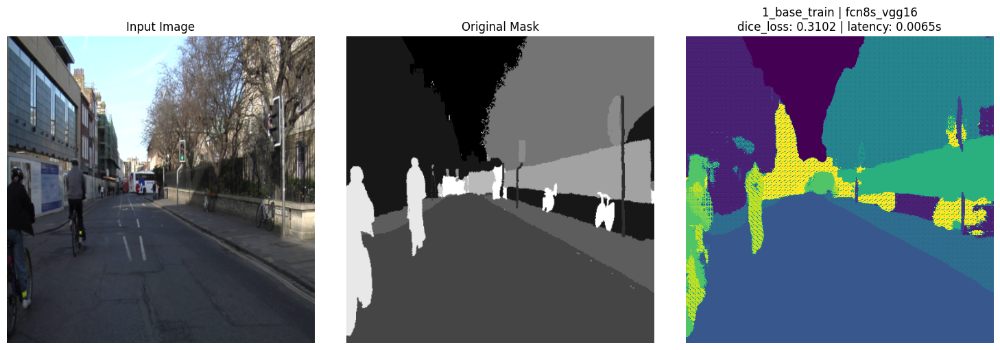

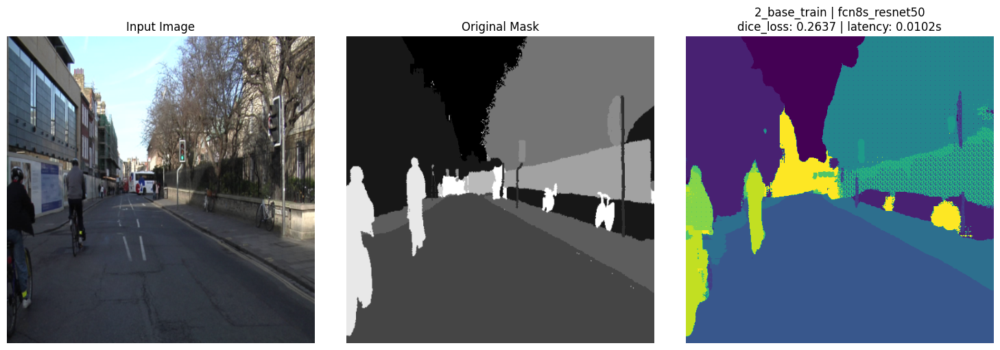

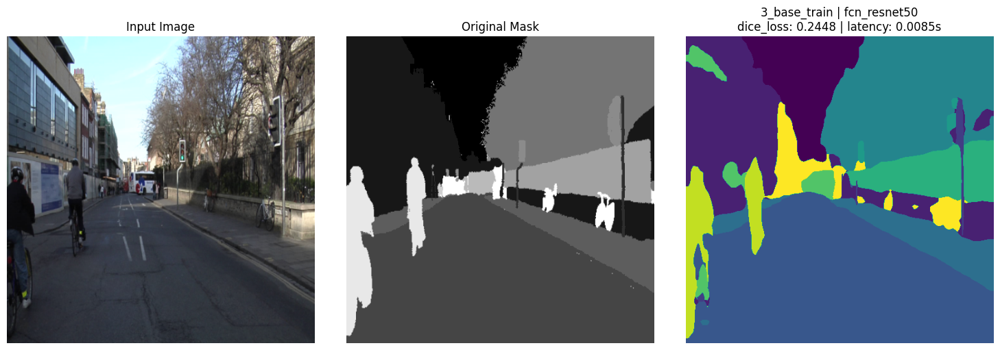

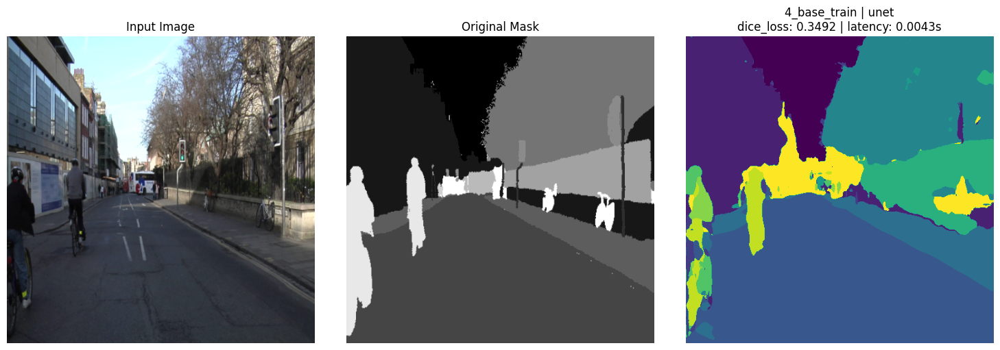

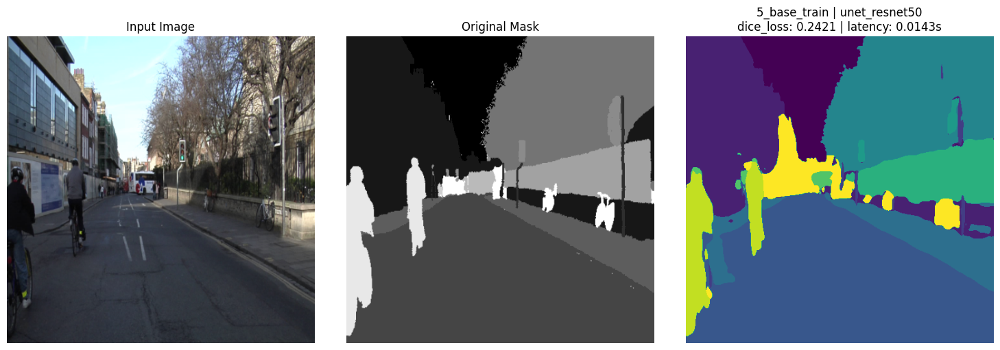

...

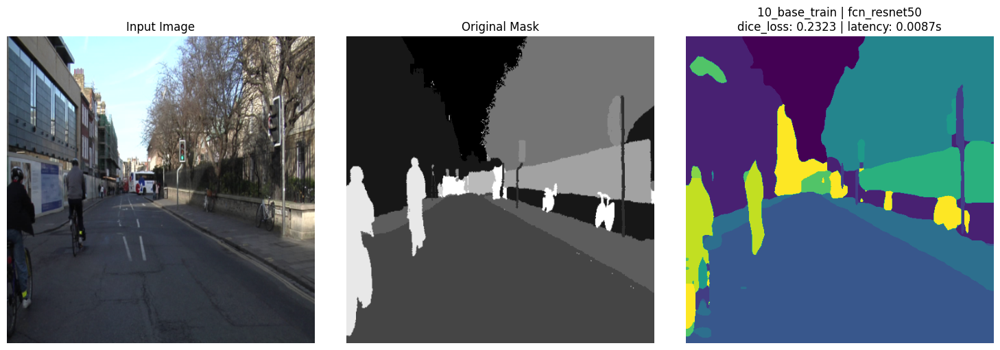

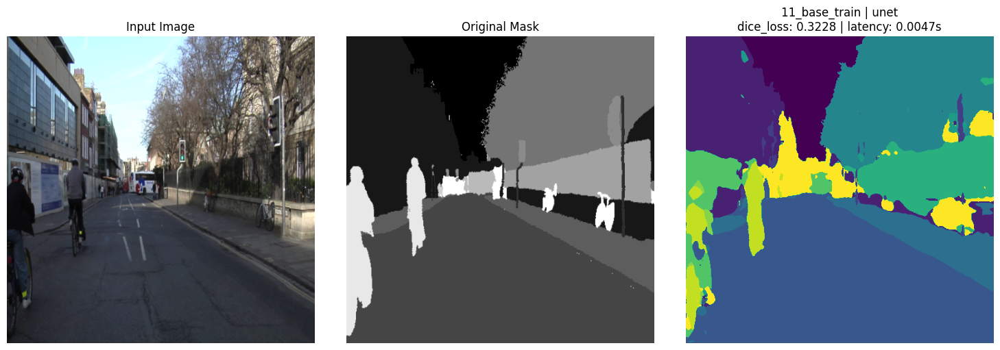

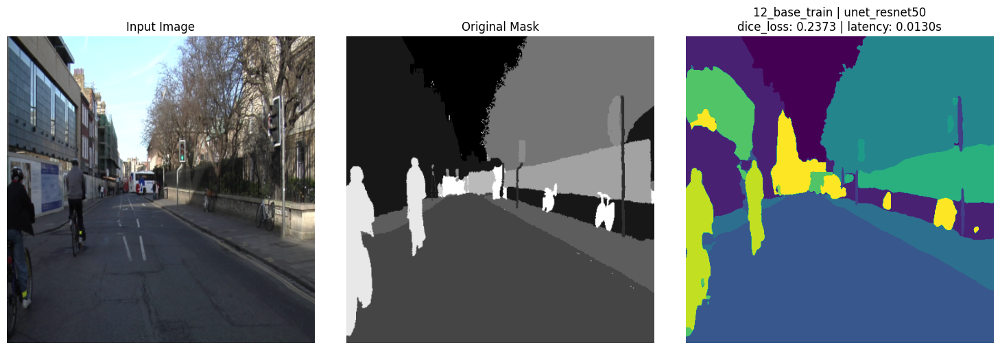

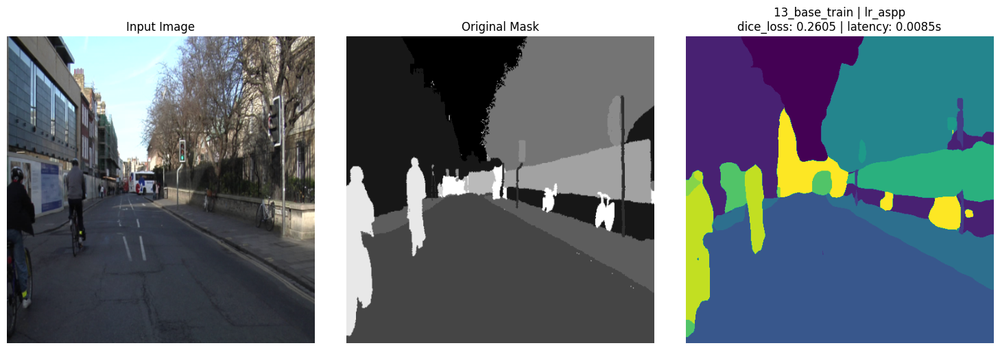

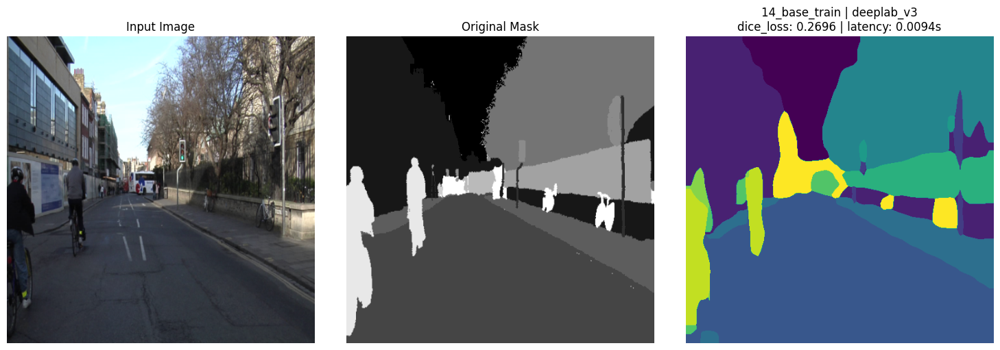

In [ ]:
import os

# Get the list of deepest child folders with their full paths from the parent folder
data_paths = list_deepest_child_folders(CHECKPOINTS_DIR)


checkpoints = []
for path in data_paths:

    # Get model info
    model_name = path.split("/")[-2]
    model_info = next((item for item in model_infos if item["name"] == model_name), None)
    model_path = f"{path}/best_model.pth"

    # Create model and send to device
    model = create_model(model_name=model_name, num_classes=12)
    model.to(device)

    # Load model state dict
    model.load_state_dict(torch.load(model_path, map_location=device))

    experiment_name = path.split("/")[-3]

    # Load experiment results
    checkpoint_path = f"{path}/checkpoint.pth"
    loaded_checkpoint = torch.load(checkpoint_path, map_location=device)
    epoch, dice_loss, training_time, experiment_setup = loaded_checkpoint['epoch'], loaded_checkpoint['dice_loss'], loaded_checkpoint['training_time'], loaded_checkpoint['experiment_setup']

    title = f"{experiment_name} | {model_name}\ndice_loss: {dice_loss:.4f}"

    # Run inference and plot result
    latency_time = infer_and_plot_dataset(title, model, test_dataset, device, 1)

    checkpoints.append({
        "experiment_name": experiment_name,
        "model_name": model_name,
        "backbone": model_info['backbone'],
        "base_weights": model_info['base_weights'],
        "learning_rate": experiment_setup['learning_rate'],
        "batch_size": experiment_setup['batch_size'],
        "early_stopping": experiment_setup['early_stopping'],
        "num_epochs": experiment_setup['num_epochs'],
        "best_epoch": epoch,
        "dice_loss": dice_loss,
        "latency_time": latency_time,
        "training_time_minute": training_time,
        "model_size_mb": os.path.getsize(model_path)  / (1024 * 1024),
        "model_path": model_path,
        "checkpoint_path": checkpoint_path,
      })

### 7.2 Experiment Summary

In [ ]:
import pandas as pd

df = pd.read_csv('experiment_results.csv')
df

,experiment_name,model_name,backbone,base_weights,learning_rate,batch_size,early_stopping,num_epochs,best_epoch,dice_loss,latency_time,training_time_minute,model_size_mb,model_path,checkpoint_path
0,1_base_train,fcn8s_vgg16,vgg16,VGG16_Weights,0.0010,8,10,1000,41,0.310176,0.006530,6.046098,512.549044,/content/drive/MyDrive/Experiment/checkpoints/...,/content/drive/MyDrive/Experiment/checkpoints/...
1,2_base_train,fcn8s_resnet50,resnet50,ResNet50_Weights,0.0010,8,10,1000,32,0.263722,0.010181,6.459095,1722.424143,/content/drive/MyDrive/Experiment/checkpoints/...,/content/drive/MyDrive/Experiment/checkpoints/...
2,3_base_train,fcn_resnet50,fcn_resnet50,FCN_ResNet50_Weights,0.0010,8,10,1000,65,0.244800,0.008455,9.876825,135.035351,/content/drive/MyDrive/Experiment/checkpoints/...,/content/drive/MyDrive/Experiment/checkpoints/...
3,4_base_train,unet,NaN,NaN,0.0010,8,10,1000,28,0.349166,0.004290,5.129580,51.176085,/content/drive/MyDrive/Experiment/checkpoints/...,/content/drive/MyDrive/Experiment/checkpoints/...
4,5_base_train,unet_resnet50,resnet50,ResNet50_Weights,0.0010,8,10,1000,33,0.242065,0.014310,6.952723,564.248440,/content/drive/MyDrive/Experiment/checkpoints/...,/content/drive/MyDrive/Experiment/checkpoints/...
5,6_base_train,lr_aspp,lraspp_mobilenet_v3_large,LRASPP_MobileNet_V3_Large_Weights,0.0010,8,10,1000,36,0.266051,0.010095,4.260459,12.483151,/content/drive/MyDrive/Experiment/checkpoints/...,/content/drive/MyDrive/Experiment/checkpoints/...
6,7_base_train,deeplab_v3,deeplabv3_mobilenet_v3_large,DeepLabV3_MobileNet_V3_Large_Weights,0.0010,8,10,1000,42,0.265378,0.010101,5.749960,42.290442,/content/drive/MyDrive/Experiment/checkpoints/...,/content/drive/MyDrive/Experiment/checkpoints/...
7,8_base_train,fcn8s_vgg16,vgg16,VGG16_Weights,0.0005,8,10,1000,35,0.289884,0.003561,5.356999,512.549044,/content/drive/MyDrive/Experiment/checkpoints/...,/content/drive/MyDrive/Experiment/checkpoints/...
8,9_base_train,fcn8s_resnet50,resnet50,ResNet50_Weights,0.0005,8,10,1000,74,0.277258,0.010720,15.273176,1722.424143,/content/drive/MyDrive/Experiment/checkpoints/...,/content/drive/MyDrive/Experiment/checkpoints/...
9,10_base_train,fcn_resnet50,fcn_resnet50,FCN_ResNet50_Weights,0.0005,8,10,1000,31,0.232259,0.008734,4.961835,135.035351,/content/drive/MyDrive/Experiment/checkpoints/...,/content/drive/MyDrive/Experiment/checkpoints/...


In [ ]:
import math

# Summary
total_training_time = math.ceil(df['training_time_minute'].sum())

hourly_rate = 1.18
per_minute_rate = hourly_rate / 60
cost = per_minute_rate * total_training_time

total_model_size = df['model_size_mb'].sum()

lowest_dice_loss_experiment = df.loc[df['dice_loss'].idxmin()]
highest_dice_loss_experiment = df.loc[df['dice_loss'].idxmax()]

smallest_model_size_experiment = df.loc[df['model_size_mb'].idxmin()]
largest_model_size_experiment = df.loc[df['model_size_mb'].idxmax()]

smallest_best_epoch_experiment = df.loc[df['best_epoch'].idxmin()]
largest_best_epoch_experiment = df.loc[df['best_epoch'].idxmax()]

longest_training_time_experiment = df.loc[df['training_time_minute'].idxmax()]
shortest_training_time_experiment = df.loc[df['training_time_minute'].idxmin()]

lowest_latency_time_experiment = df.loc[df['latency_time'].idxmin()]
highest_latency_time_experiment = df.loc[df['latency_time'].idxmax()]

# Display Summary
print("Total Training Time:", total_training_time, "minutes")
print("Total Training Cost on A100 GPU:", f"${cost:.2f}")
print("Total Saved Model Size:", f"{(total_model_size /(1024)):.2f}", "GB")
print("\nExperiment with Lowest Dice Loss:")
print(lowest_dice_loss_experiment['experiment_name'])
print("\nExperiment with Highest Dice Loss:")
print(highest_dice_loss_experiment['experiment_name'])
print("\nExperiment with Smallest Model Size:")
print(smallest_model_size_experiment['experiment_name'])
print("\nExperiment with Largest Model Size:")
print(largest_model_size_experiment['experiment_name'])
print("\nExperiment with Smallest Best Epoch:")
print(smallest_best_epoch_experiment['experiment_name'])
print("\nExperiment with Largest Best Epoch:")
print(largest_best_epoch_experiment['experiment_name'])
print("\nExperiment with Longest Training Time:")
print(longest_training_time_experiment['experiment_name'])
print("\nExperiment with Shortest Training Time:")
print(shortest_training_time_experiment['experiment_name'])
print("\nExperiment with Lowest Latency Time:")
print(lowest_latency_time_experiment['experiment_name'])
print("\nExperiment with Highest Latency Time:")
print(highest_latency_time_experiment['experiment_name'])

Total Training Time: 107 minutes
Total Training Cost on A100 GPU: $2.10
Total Saved Model Size: 5.94 GB

Experiment with Lowest Dice Loss:
10_base_train

Experiment with Highest Dice Loss:
4_base_train

Experiment with Smallest Model Size:
6_base_train

Experiment with Largest Model Size:
2_base_train

Experiment with Smallest Best Epoch:
4_base_train

Experiment with Largest Best Epoch:
9_base_train

Experiment with Longest Training Time:
12_base_train

Experiment with Shortest Training Time:
6_base_train

Experiment with Lowest Latency Time:
8_base_train

Experiment with Highest Latency Time:
5_base_train


## Experiment Tracker

### Let's view our experiments from within the notebook

In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/Experiment/runs


The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 437), started 0:01:23 ago. (Use '!kill 437' to kill it.)

<IPython.core.display.Javascript object>